# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [5]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    #print(f"xtype {x.dtype}")
    #print(f"ytype {y.dtype}")
    combined = torch.cat((x.float(),y.float()),dim=1)
    #### END CODE HERE ####
    return combined

In [17]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [6]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [7]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [8]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = n_classes + mnist_shape[0]
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [23]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [9]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.250103029727936, discriminator loss: 0.25688271840661764


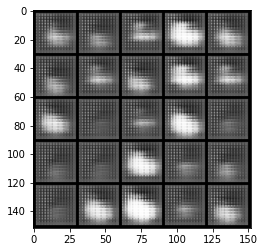

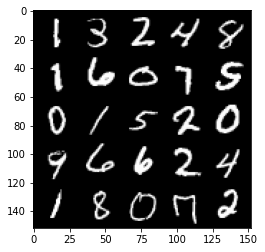

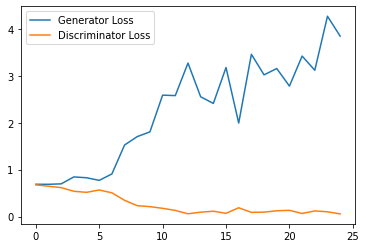

Step 1000: Generator loss: 4.110953500032425, discriminator loss: 0.06664936474710703


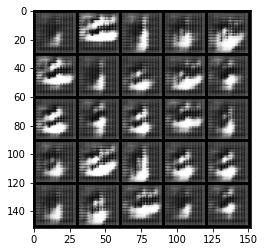

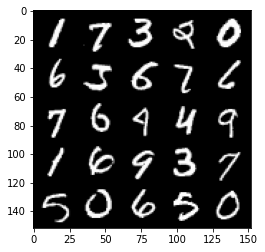

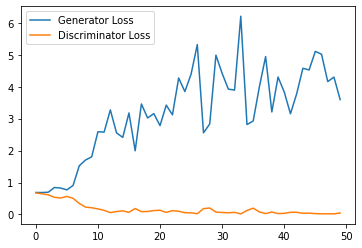

Step 1500: Generator loss: 4.060484122276306, discriminator loss: 0.06359420398063957


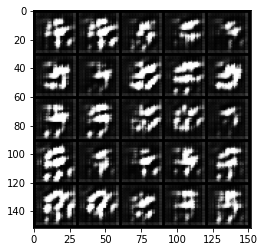

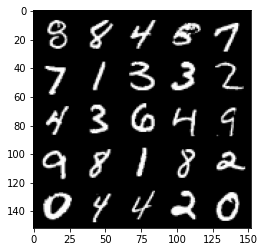

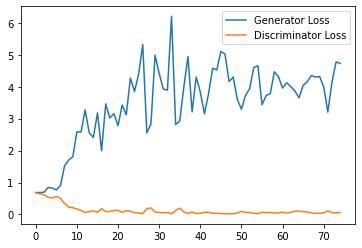

Step 2000: Generator loss: 3.2228144121170046, discriminator loss: 0.1397593033462763


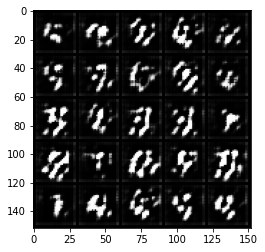

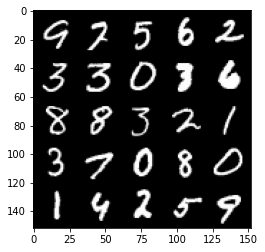

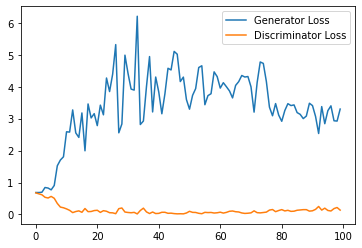

Step 2500: Generator loss: 2.5386758329868315, discriminator loss: 0.21367343777418138


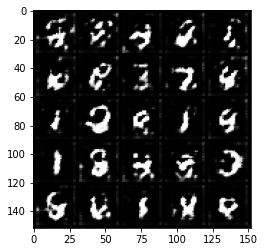

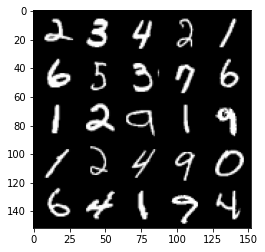

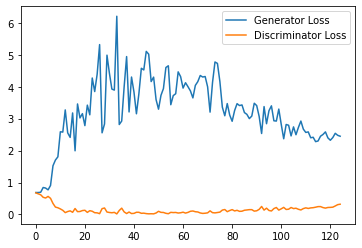

Step 3000: Generator loss: 2.3237197628021242, discriminator loss: 0.3069458276629448


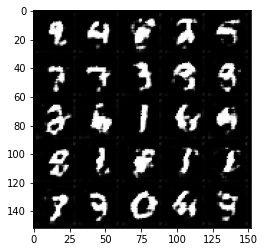

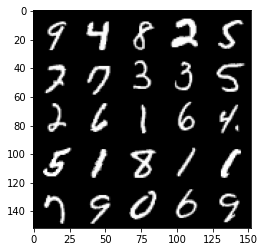

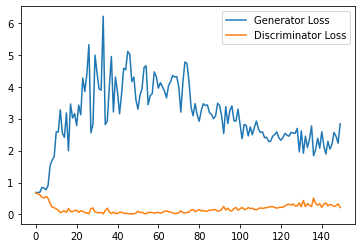

Step 3500: Generator loss: 2.1166609065532684, discriminator loss: 0.3205259082317352


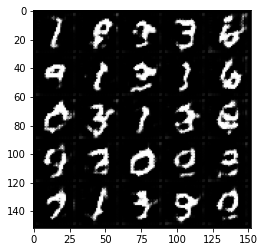

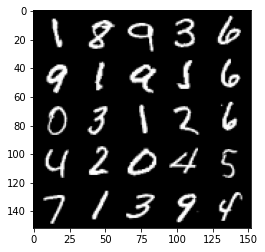

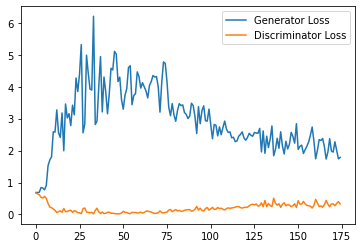

Step 4000: Generator loss: 2.0073738300800326, discriminator loss: 0.30397423696517945


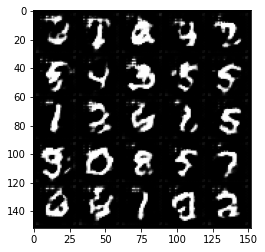

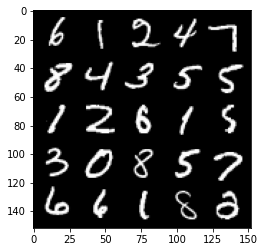

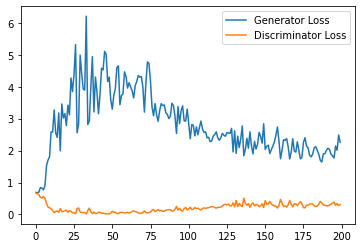

Step 4500: Generator loss: 2.001700023174286, discriminator loss: 0.35398175013065336


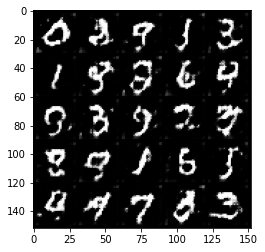

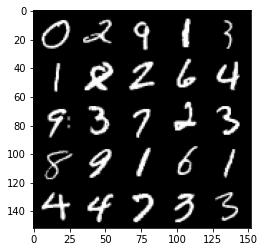

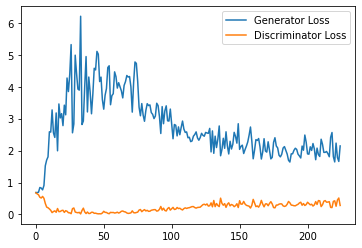

Step 5000: Generator loss: 1.756447509288788, discriminator loss: 0.3840618976354599


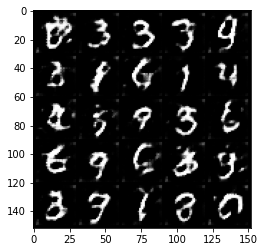

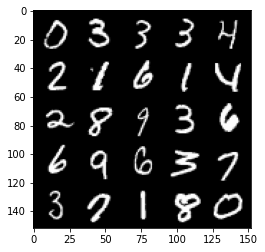

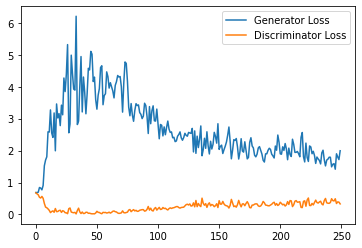

Step 5500: Generator loss: 1.678459500312805, discriminator loss: 0.4255598249435425


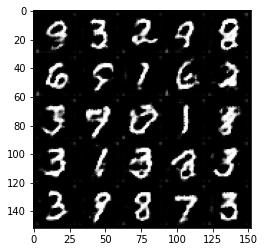

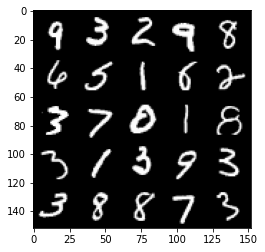

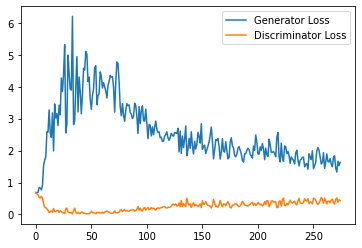

Step 6000: Generator loss: 1.5868639742136001, discriminator loss: 0.4411050506830215


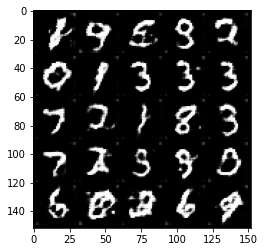

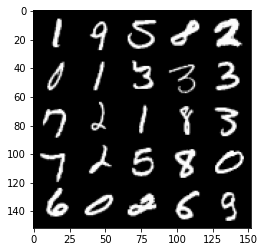

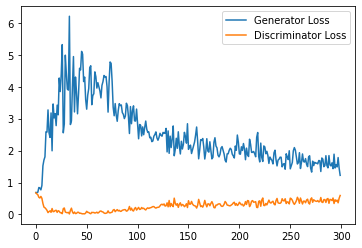

Step 6500: Generator loss: 1.4547294441461562, discriminator loss: 0.4765951335430145


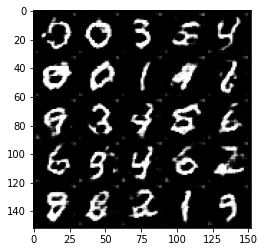

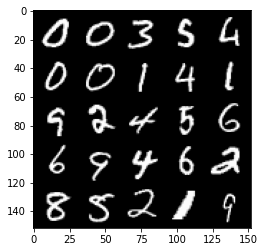

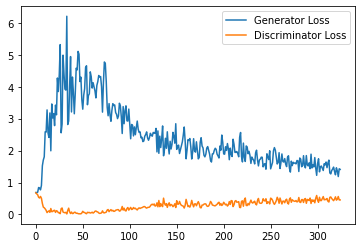

Step 7000: Generator loss: 1.3880381740331649, discriminator loss: 0.49554579734802245


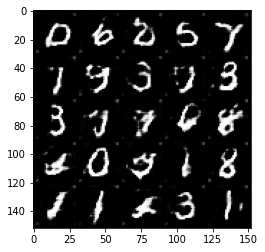

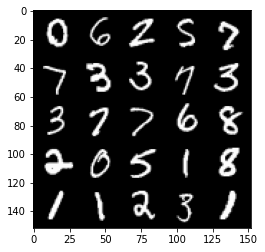

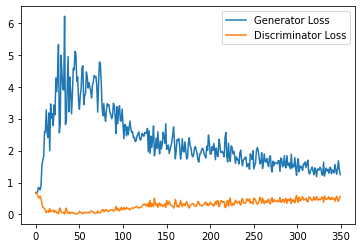

Step 7500: Generator loss: 1.3411913157701492, discriminator loss: 0.5296852194666862


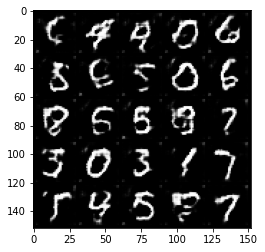

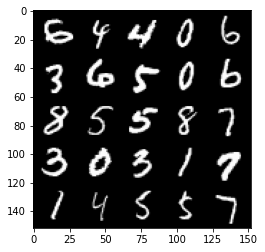

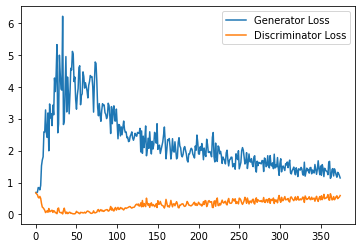

Step 8000: Generator loss: 1.274490805864334, discriminator loss: 0.5402186793088913


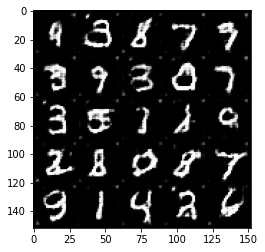

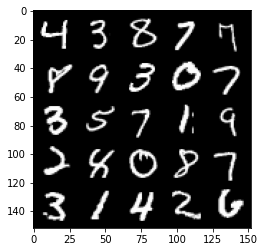

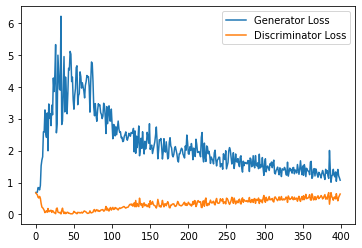

Step 8500: Generator loss: 1.3145214959383011, discriminator loss: 0.5361405233740807


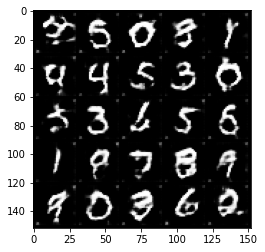

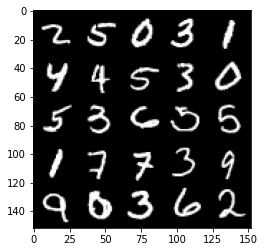

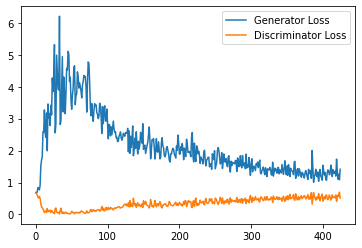

Step 9000: Generator loss: 1.2840518236160279, discriminator loss: 0.5375228343605996


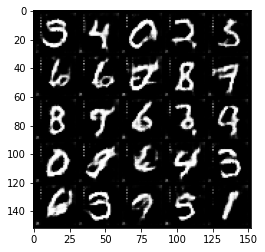

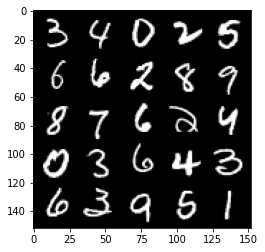

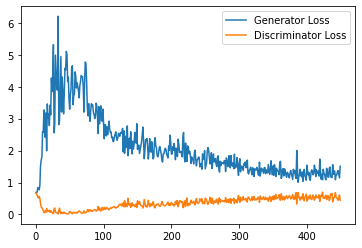

Step 9500: Generator loss: 1.2666662994623183, discriminator loss: 0.5539494643807411


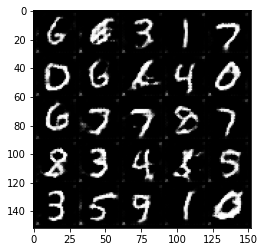

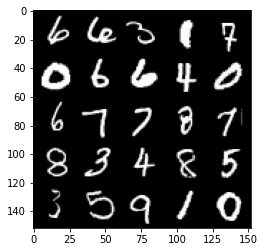

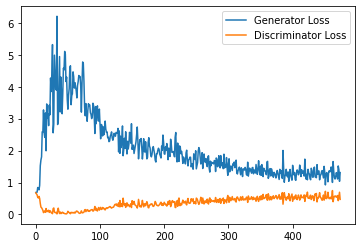

Step 10000: Generator loss: 1.2157427369356155, discriminator loss: 0.5437131511569023


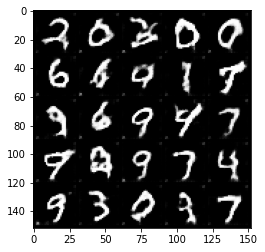

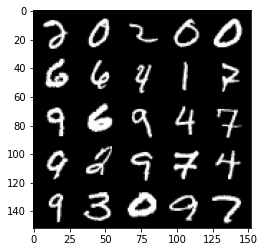

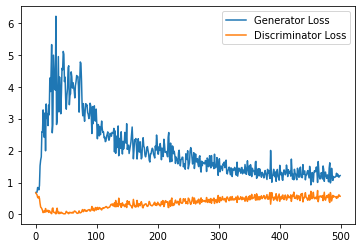

Step 10500: Generator loss: 1.223480931520462, discriminator loss: 0.5503101222515107


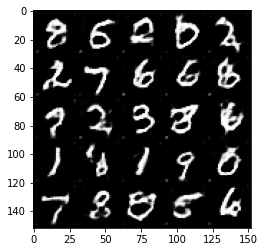

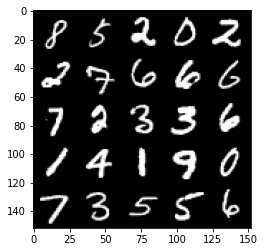

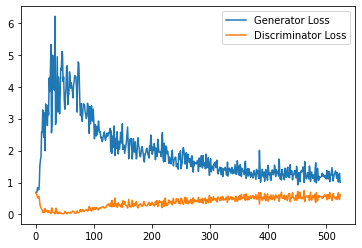

Step 11000: Generator loss: 1.142774968624115, discriminator loss: 0.5615736579298973


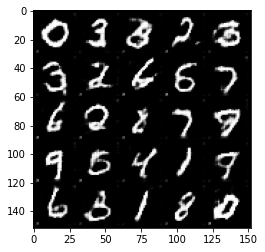

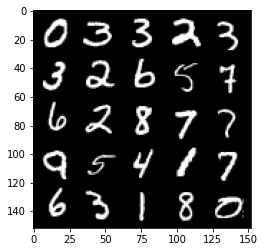

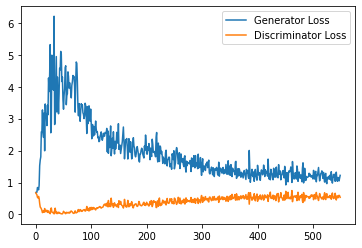

Step 11500: Generator loss: 1.1826386691331863, discriminator loss: 0.5564970486760139


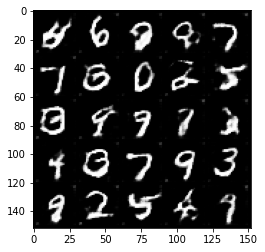

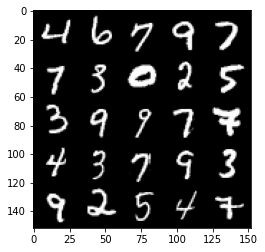

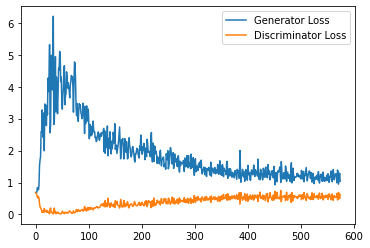

Step 12000: Generator loss: 1.135624668955803, discriminator loss: 0.5614563126564026


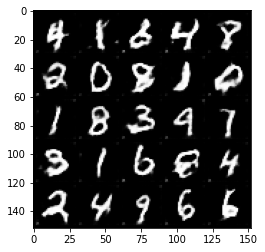

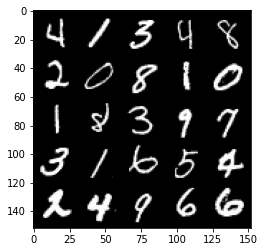

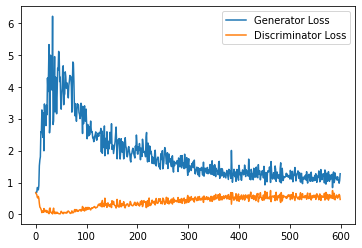

Step 12500: Generator loss: 1.16346373963356, discriminator loss: 0.5562781960964203


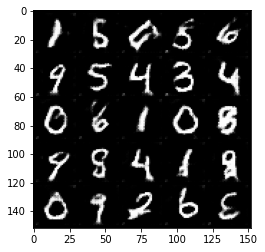

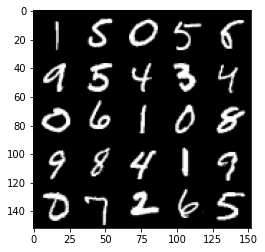

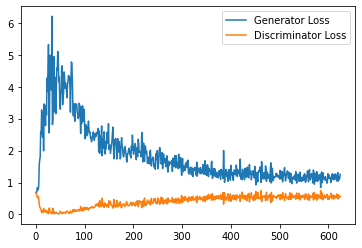

Step 13000: Generator loss: 1.209960070490837, discriminator loss: 0.574579639852047


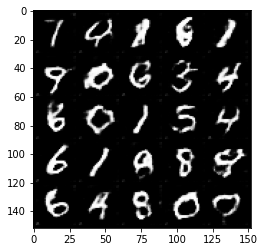

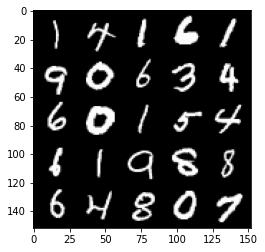

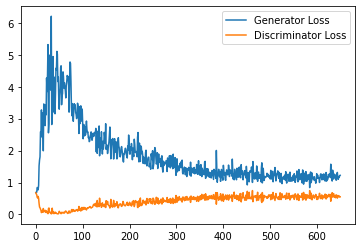

Step 13500: Generator loss: 1.1701516970396042, discriminator loss: 0.5709742815494537


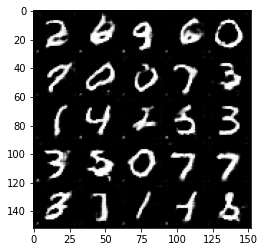

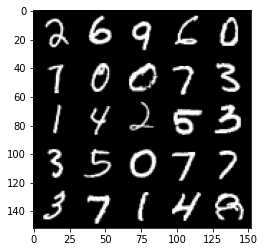

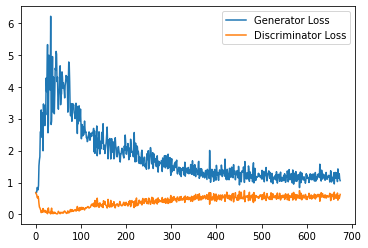

Step 14000: Generator loss: 1.1019265936613083, discriminator loss: 0.5800310151576996


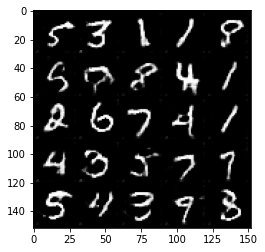

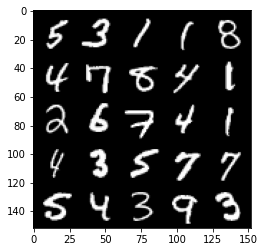

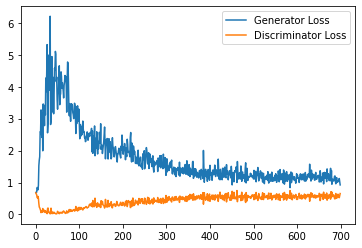

Step 14500: Generator loss: 1.0583336517810822, discriminator loss: 0.5692193983793259


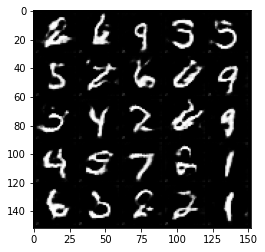

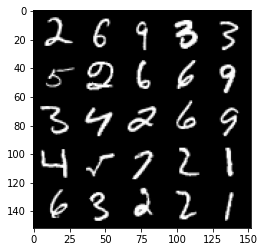

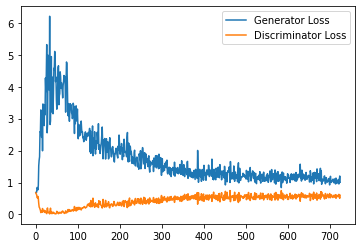

Step 15000: Generator loss: 1.1113239798545838, discriminator loss: 0.5719946167469024


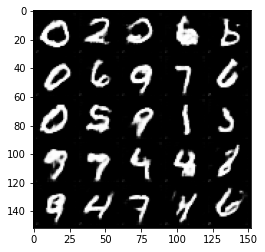

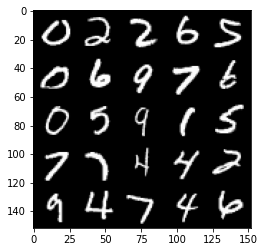

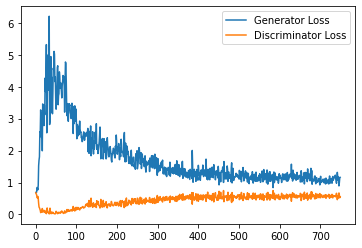

Step 15500: Generator loss: 1.093907283782959, discriminator loss: 0.5837696426510811


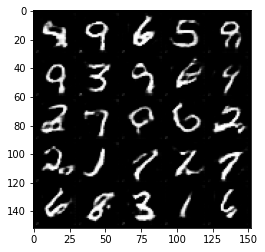

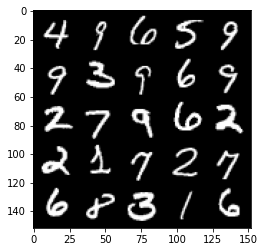

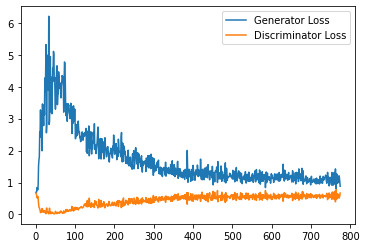

Step 16000: Generator loss: 1.0916620621681212, discriminator loss: 0.5743426192998886


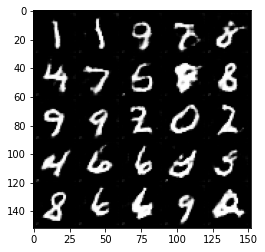

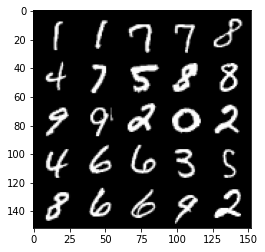

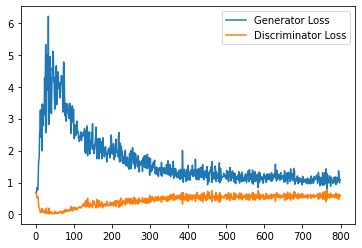

Step 16500: Generator loss: 1.0655105979442596, discriminator loss: 0.5746119332909584


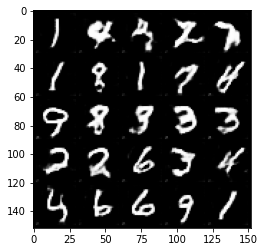

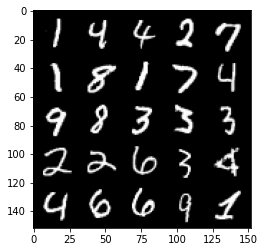

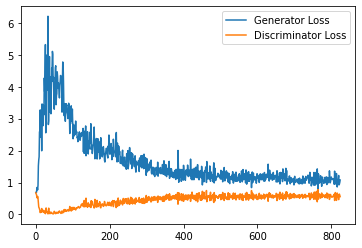

Step 17000: Generator loss: 1.045989090681076, discriminator loss: 0.5822337841391564


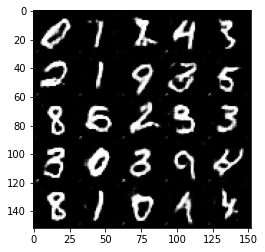

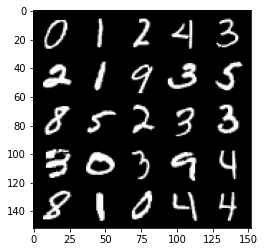

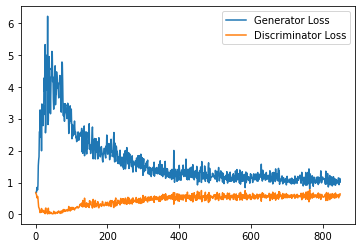

Step 17500: Generator loss: 1.090703164577484, discriminator loss: 0.571754021525383


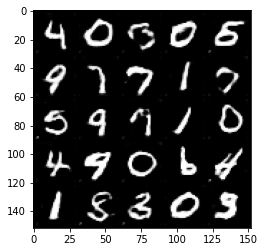

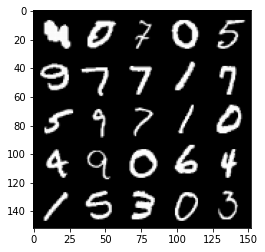

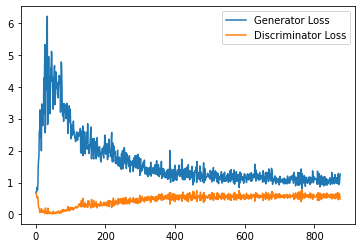

Step 18000: Generator loss: 1.0394963774681092, discriminator loss: 0.5864956641793251


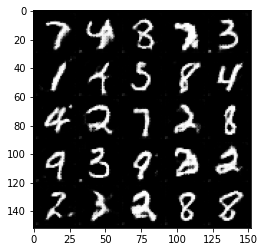

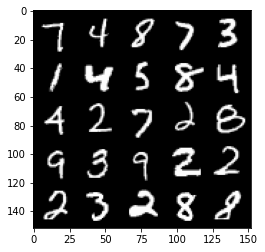

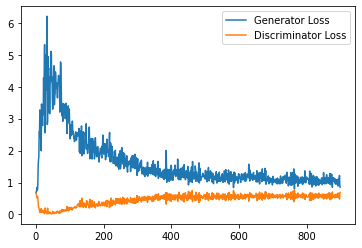

Step 18500: Generator loss: 1.0932239739894867, discriminator loss: 0.5759583309888839


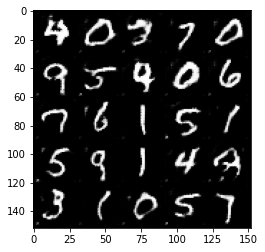

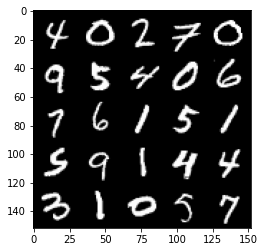

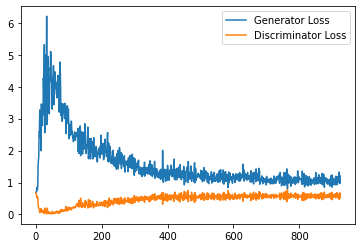

Step 19000: Generator loss: 1.052567445397377, discriminator loss: 0.583299155652523


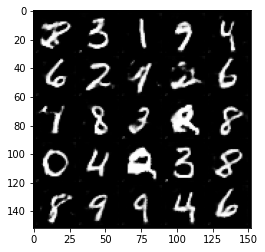

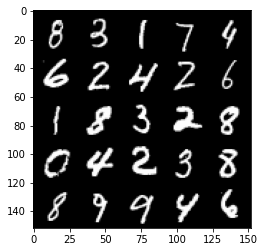

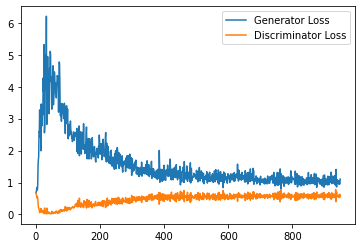

Step 19500: Generator loss: 1.0374960119724275, discriminator loss: 0.5811425288915634


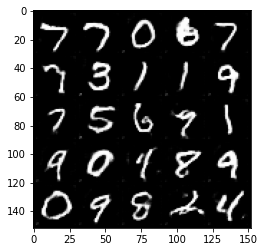

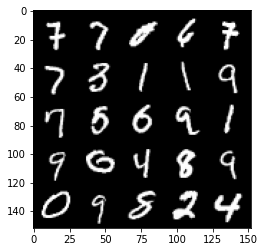

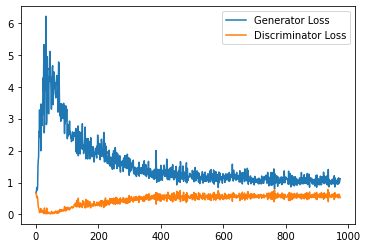

Step 20000: Generator loss: 1.0225053449869157, discriminator loss: 0.5841381226778031


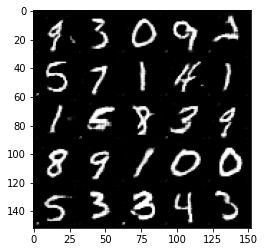

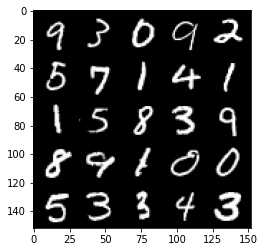

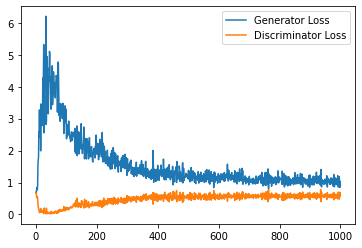

Step 20500: Generator loss: 1.0667900344133376, discriminator loss: 0.5833624651432038


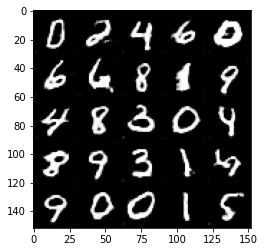

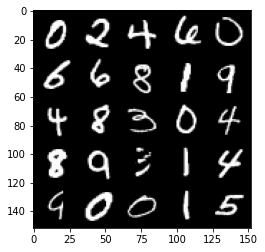

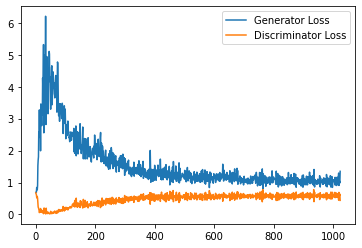

Step 21000: Generator loss: 1.0730707906484604, discriminator loss: 0.5790523845553398


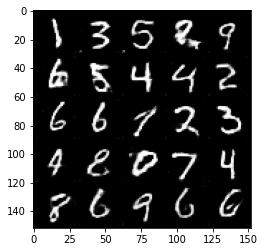

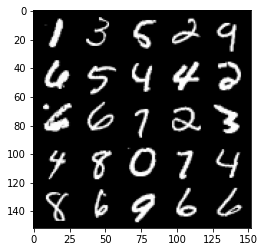

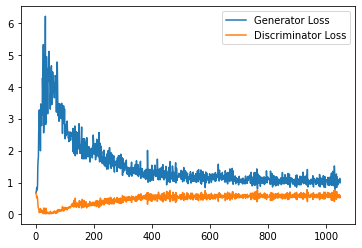

Step 21500: Generator loss: 1.020988271832466, discriminator loss: 0.5845970576405525


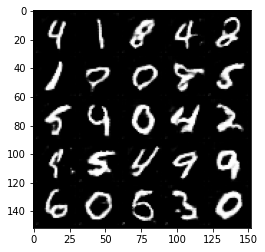

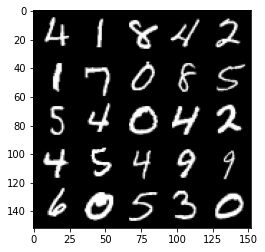

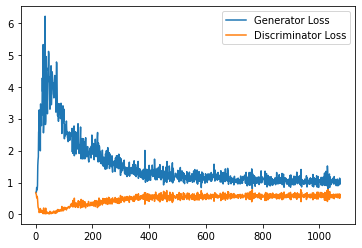

Step 22000: Generator loss: 1.0378966082334518, discriminator loss: 0.5822368906140327


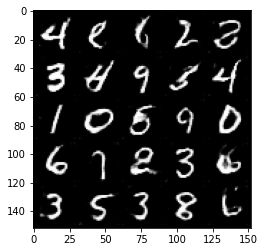

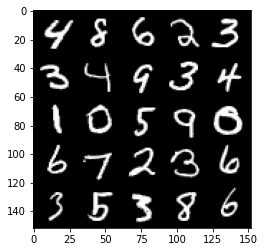

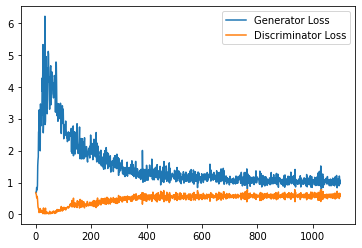

Step 22500: Generator loss: 1.0329933986663817, discriminator loss: 0.5866855996847152


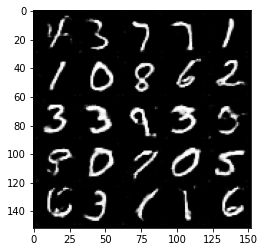

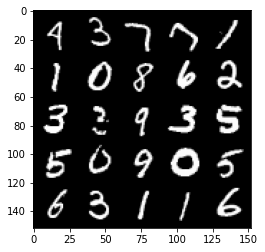

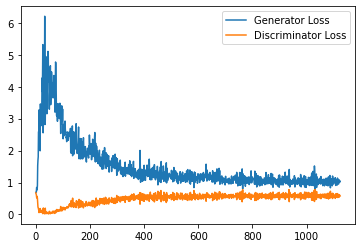

Step 23000: Generator loss: 1.0366331266164779, discriminator loss: 0.5882765244245529


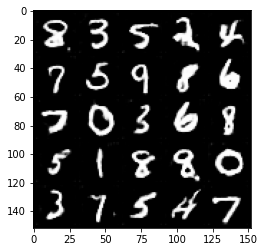

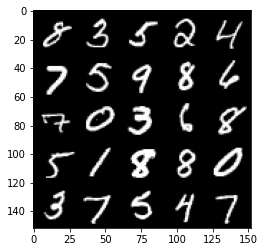

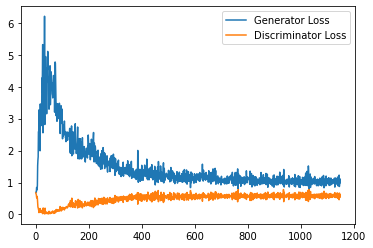

Step 23500: Generator loss: 1.027459368944168, discriminator loss: 0.5830545842051506


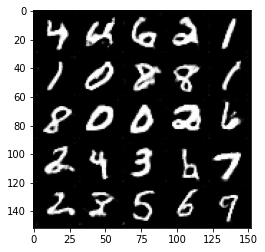

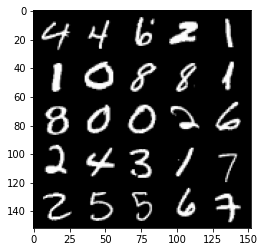

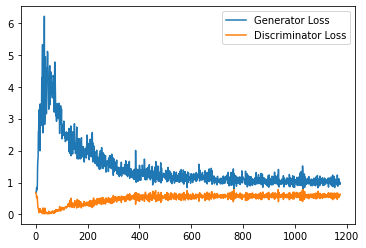

Step 24000: Generator loss: 1.0411089479923248, discriminator loss: 0.5878779453039169


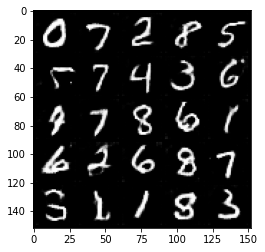

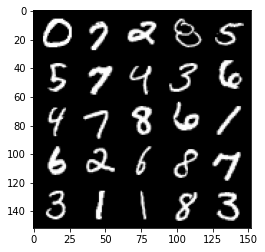

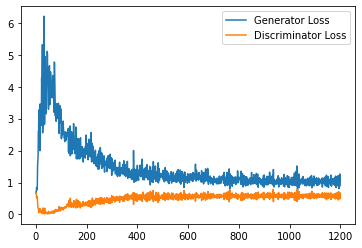

Step 24500: Generator loss: 1.010380313038826, discriminator loss: 0.5868400213718414


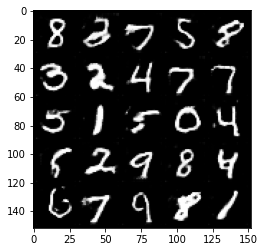

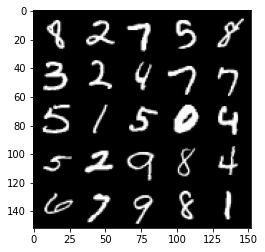

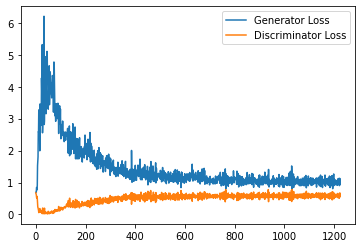

Step 25000: Generator loss: 1.0223583444356918, discriminator loss: 0.5846550909876823


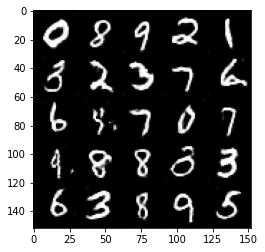

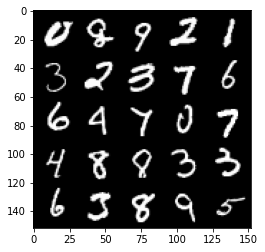

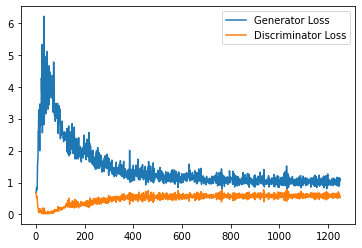

Step 25500: Generator loss: 1.0121749511957168, discriminator loss: 0.5854321446418762


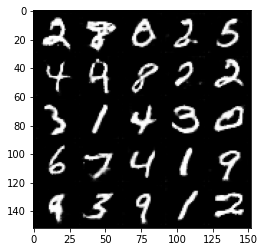

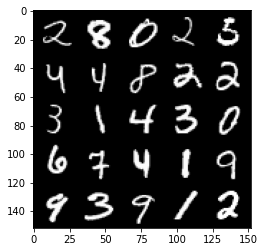

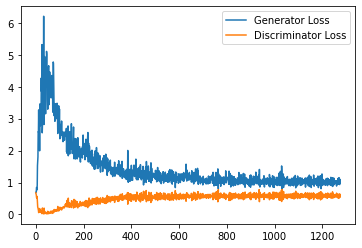

Step 26000: Generator loss: 1.0449641382694244, discriminator loss: 0.5802539696693421


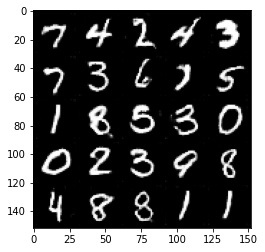

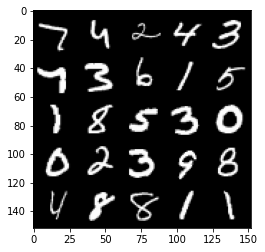

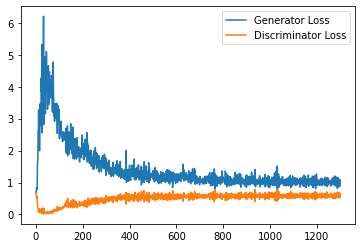

Step 26500: Generator loss: 1.0201270017623902, discriminator loss: 0.5816150374412536


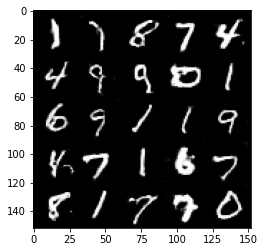

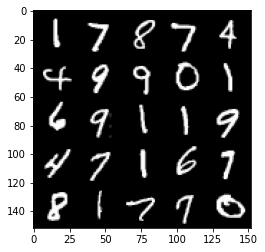

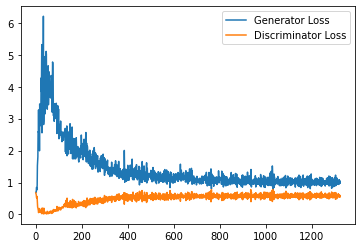

Step 27000: Generator loss: 1.0100425494909286, discriminator loss: 0.5845531069040298


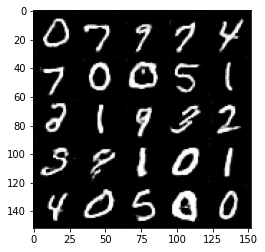

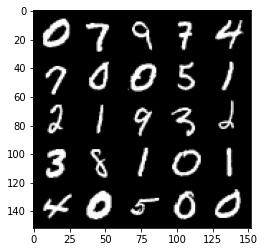

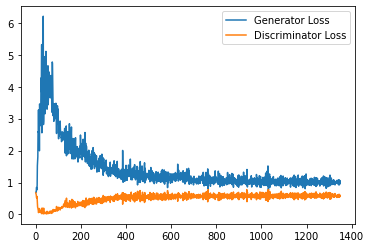

Step 27500: Generator loss: 1.0269865301847458, discriminator loss: 0.58449710470438


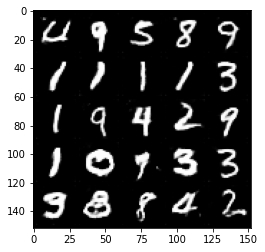

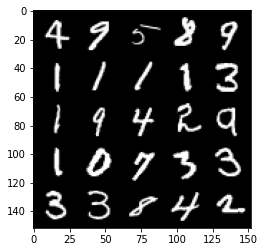

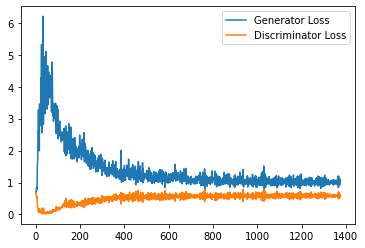

Step 28000: Generator loss: 1.0274095411300659, discriminator loss: 0.5777586330175399


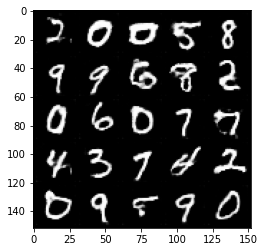

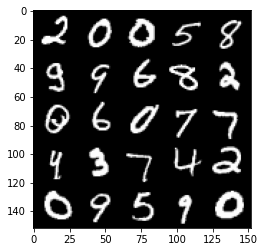

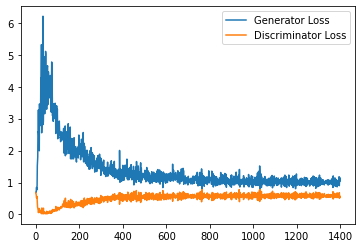

Step 28500: Generator loss: 1.0465094525814056, discriminator loss: 0.5762250433564187


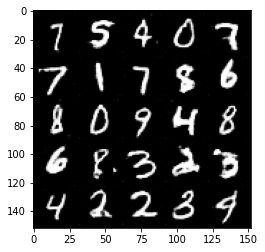

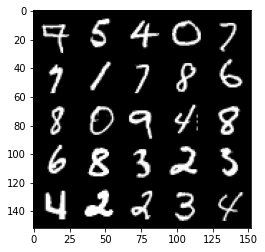

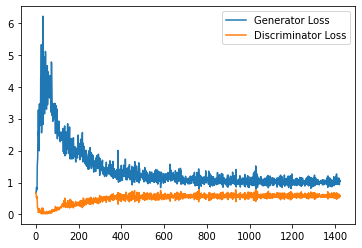

Step 29000: Generator loss: 1.0290150762796402, discriminator loss: 0.5839541890621185


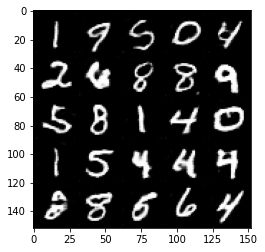

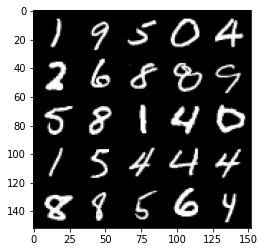

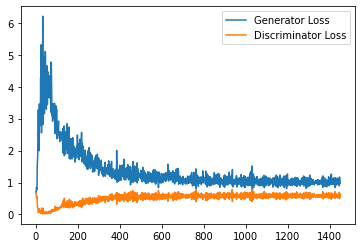

Step 29500: Generator loss: 1.0198380908966065, discriminator loss: 0.5767448692917824


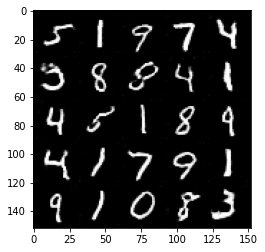

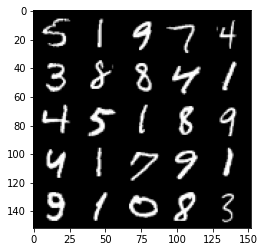

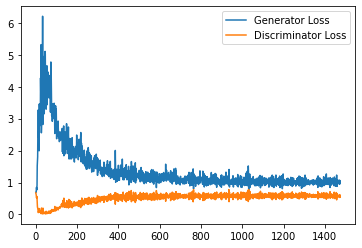

Step 30000: Generator loss: 1.0270946002006531, discriminator loss: 0.5698895655870437


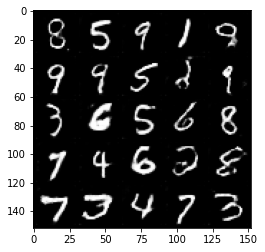

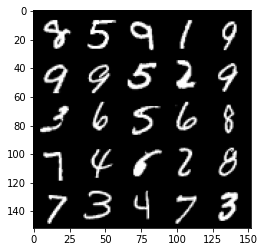

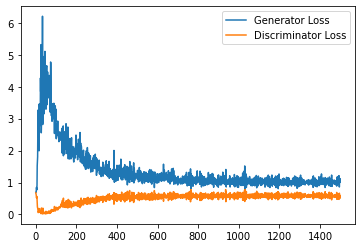

Step 30500: Generator loss: 1.0241827951669693, discriminator loss: 0.5797219489216805


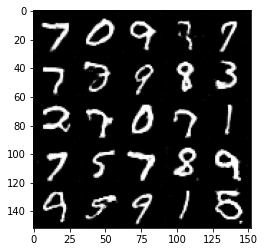

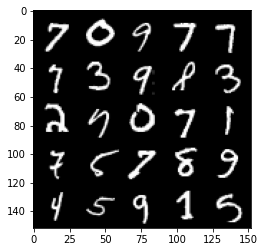

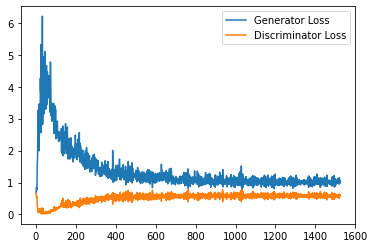

Step 31000: Generator loss: 1.0408530752658844, discriminator loss: 0.5765428938865662


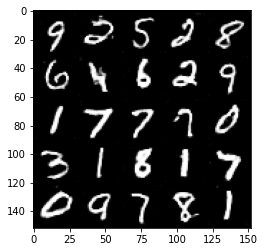

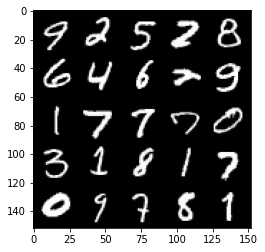

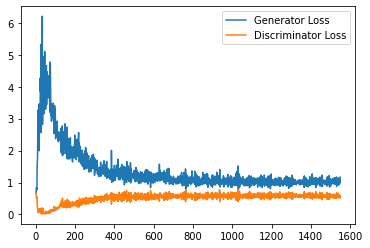

Step 31500: Generator loss: 1.0295314489603042, discriminator loss: 0.581756732404232


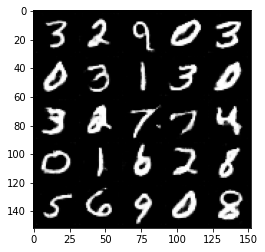

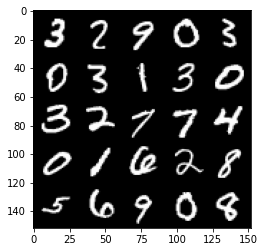

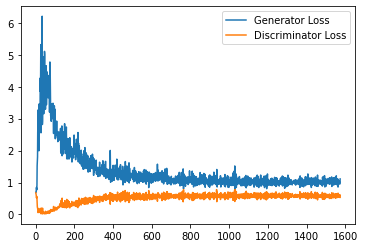

Step 32000: Generator loss: 1.0407876471281052, discriminator loss: 0.5808579832315445


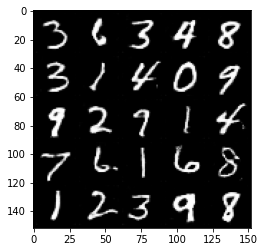

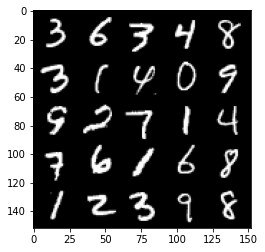

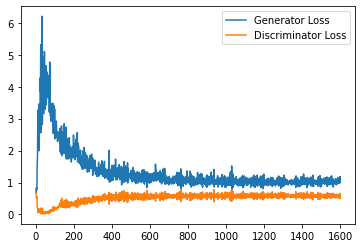

Step 32500: Generator loss: 1.0194118955135345, discriminator loss: 0.5826306515336037


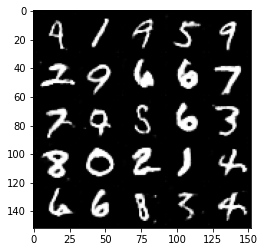

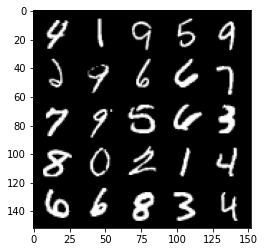

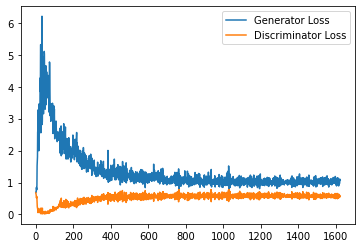

Step 33000: Generator loss: 1.0447177336215974, discriminator loss: 0.5783642171621323


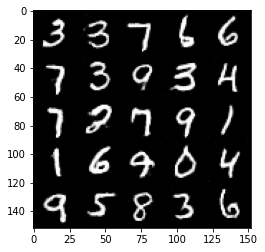

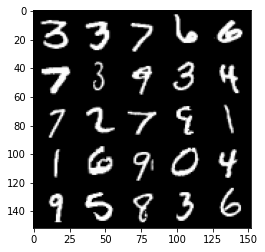

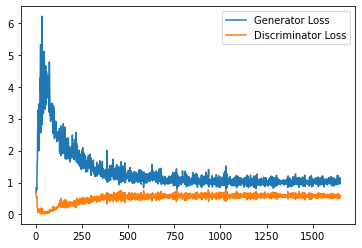

Step 33500: Generator loss: 1.0337972255945205, discriminator loss: 0.5772451539039611


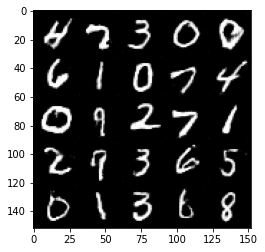

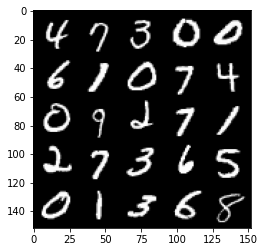

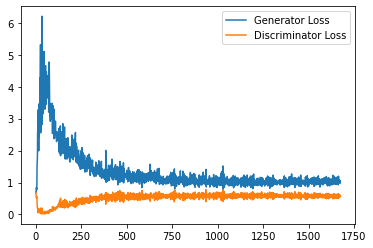

Step 34000: Generator loss: 1.054658462047577, discriminator loss: 0.5801977715492248


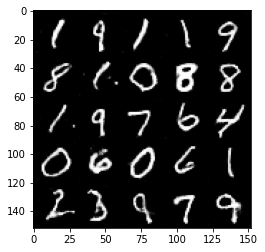

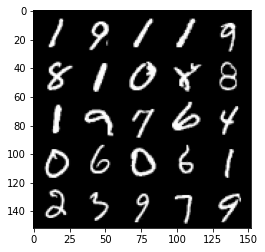

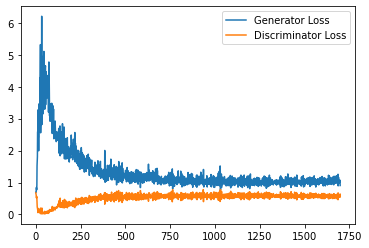

Step 34500: Generator loss: 1.0308908801078795, discriminator loss: 0.5709523539543152


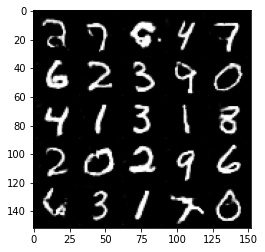

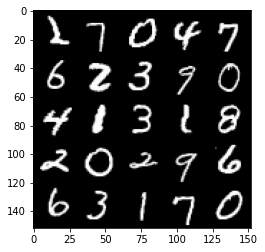

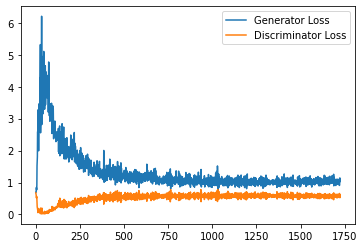

Step 35000: Generator loss: 1.0174606531858443, discriminator loss: 0.5744327291846275


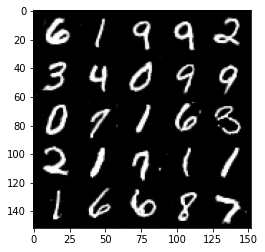

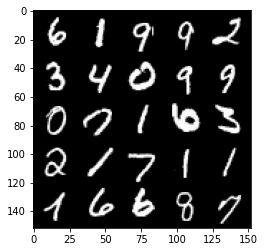

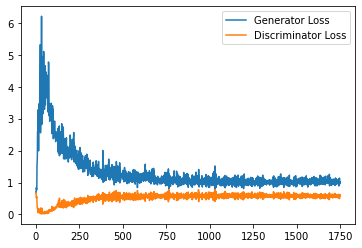

Step 35500: Generator loss: 1.054567134976387, discriminator loss: 0.5650413427948952


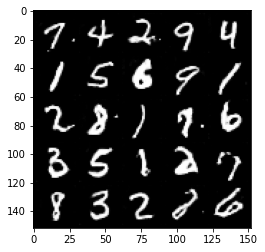

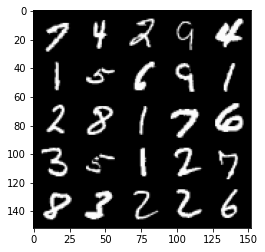

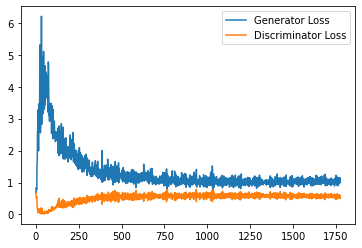

Step 36000: Generator loss: 1.047881909251213, discriminator loss: 0.5667241597175598


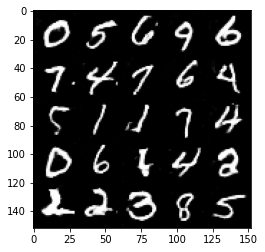

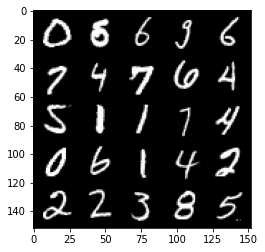

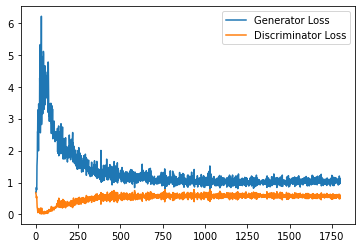

Step 36500: Generator loss: 1.05369679915905, discriminator loss: 0.5712013335824013


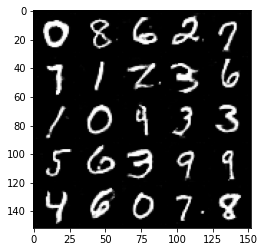

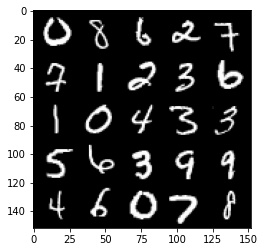

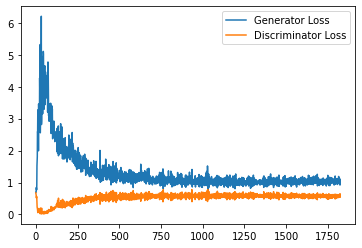

Step 37000: Generator loss: 1.0604243422746658, discriminator loss: 0.5682657287716866


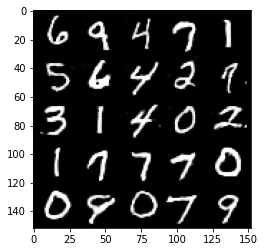

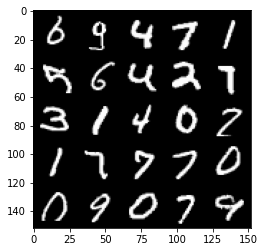

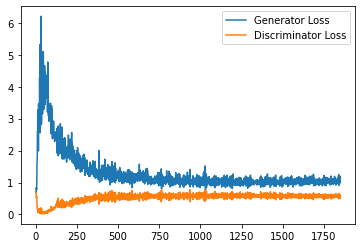

Step 37500: Generator loss: 1.0541176670789718, discriminator loss: 0.5685494810342788


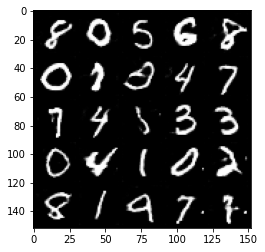

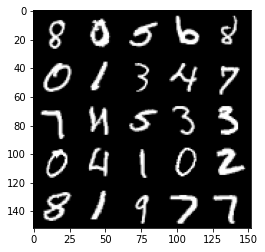

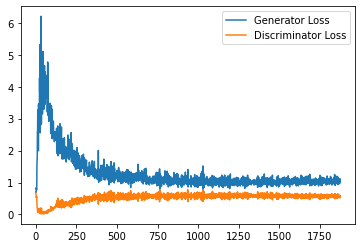

Step 38000: Generator loss: 1.0569506336450576, discriminator loss: 0.5639378204345703


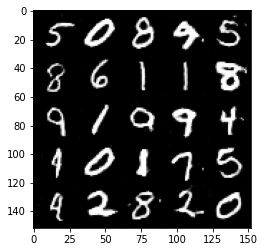

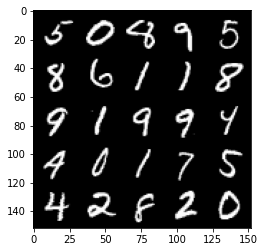

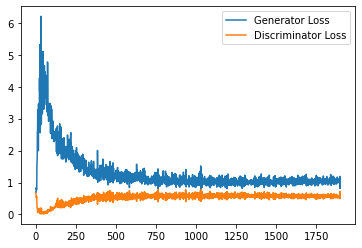

Step 38500: Generator loss: 1.0623357255458832, discriminator loss: 0.5645030246973037


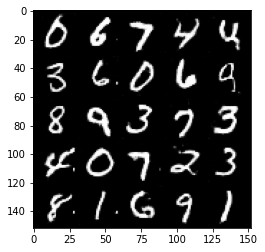

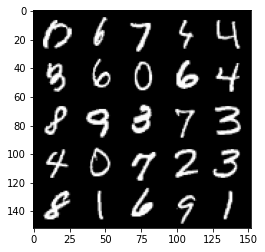

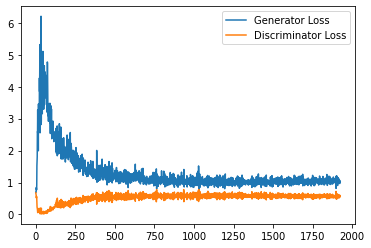

Step 39000: Generator loss: 1.085568962574005, discriminator loss: 0.561117589712143


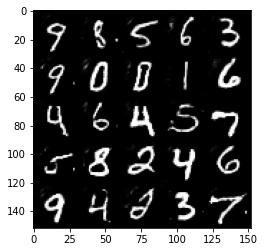

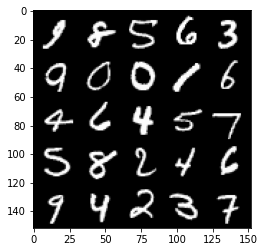

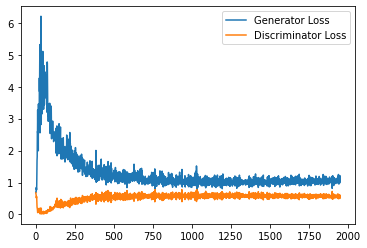

Step 39500: Generator loss: 1.0706338725090028, discriminator loss: 0.5669523313641548


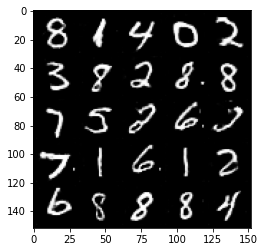

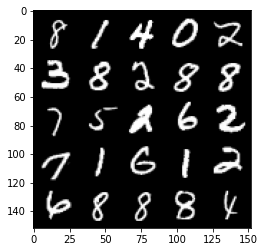

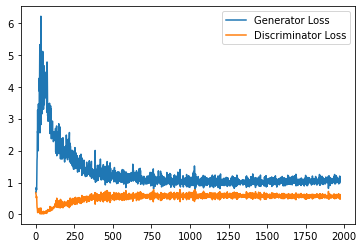

Step 40000: Generator loss: 1.0708073747158051, discriminator loss: 0.5583639450073242


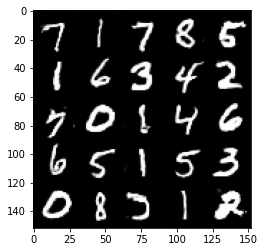

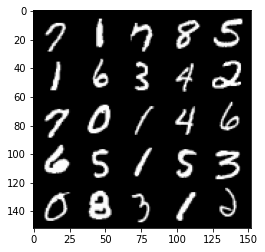

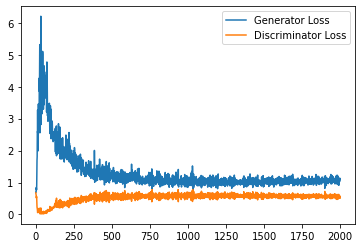

Step 40500: Generator loss: 1.0675439940690994, discriminator loss: 0.5606724147796631


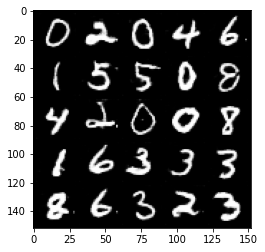

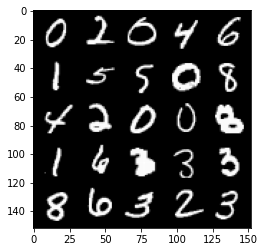

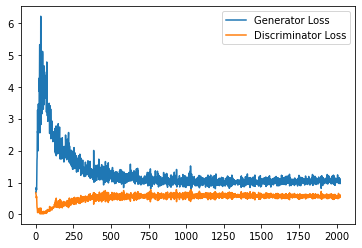

Step 41000: Generator loss: 1.077751699566841, discriminator loss: 0.5648838707208633


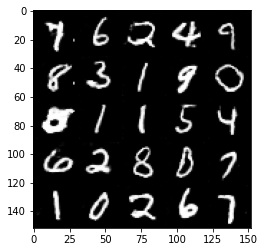

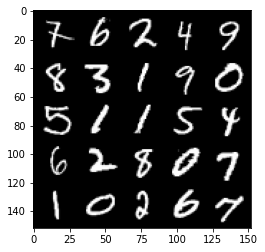

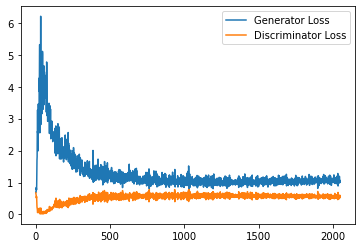

Step 41500: Generator loss: 1.067829671740532, discriminator loss: 0.5607323991656303


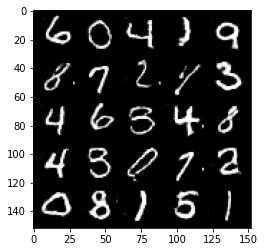

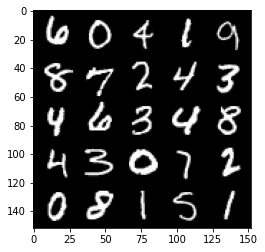

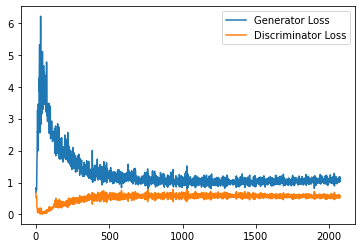

Step 42000: Generator loss: 1.068231845140457, discriminator loss: 0.5626655811071396


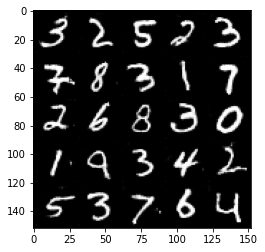

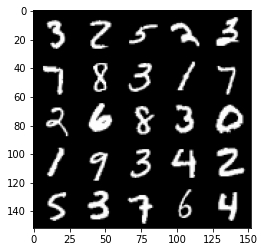

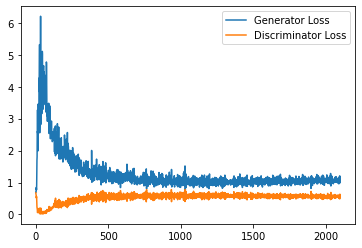

Step 42500: Generator loss: 1.0803911023139954, discriminator loss: 0.566408471941948


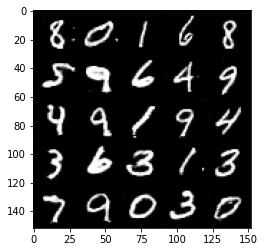

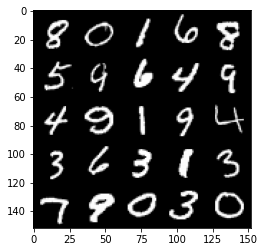

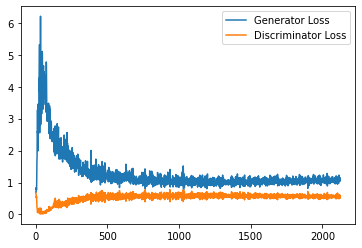

Step 43000: Generator loss: 1.086010234475136, discriminator loss: 0.5626676787734032


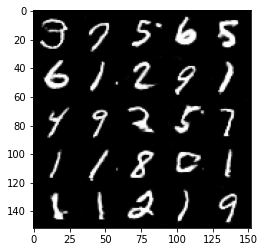

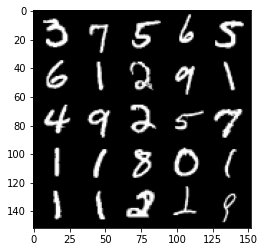

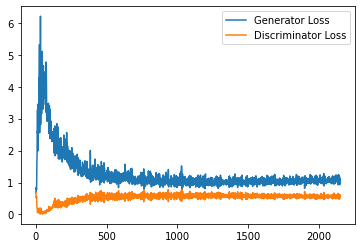

Step 43500: Generator loss: 1.072530380129814, discriminator loss: 0.559968143939972


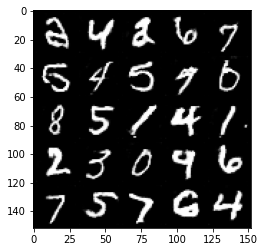

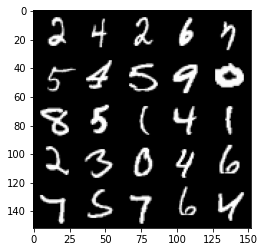

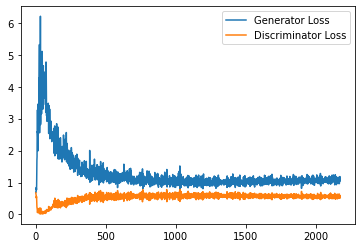

Step 44000: Generator loss: 1.1072463476657868, discriminator loss: 0.5597129672169685


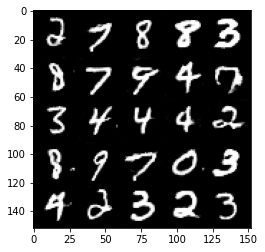

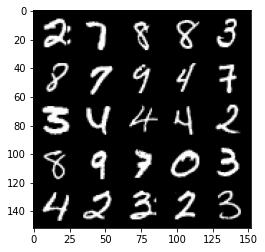

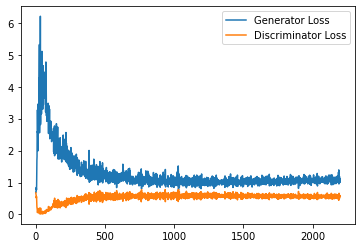

Step 44500: Generator loss: 1.0639972871541976, discriminator loss: 0.562580869615078


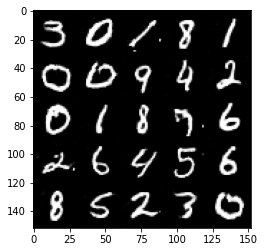

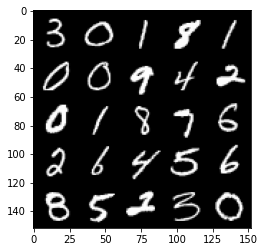

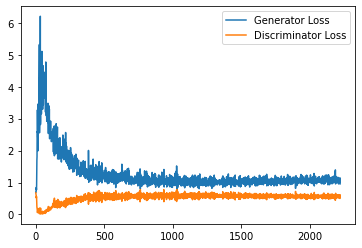

Step 45000: Generator loss: 1.0758490549325943, discriminator loss: 0.5646523714065552


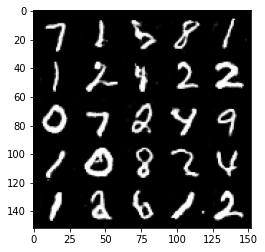

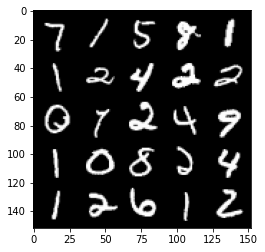

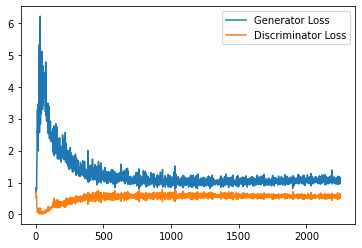

Step 45500: Generator loss: 1.0806611640453339, discriminator loss: 0.5605158314108849


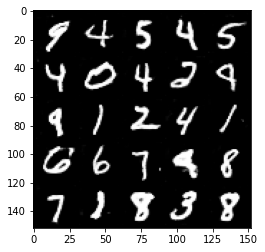

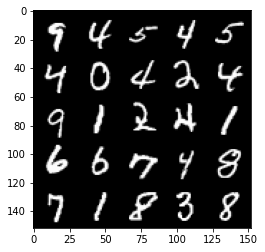

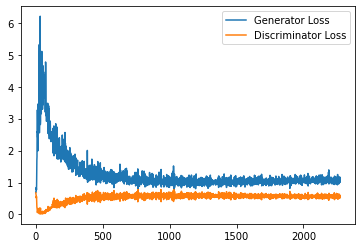

Step 46000: Generator loss: 1.0645851422548294, discriminator loss: 0.5566289254426956


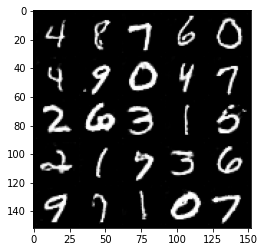

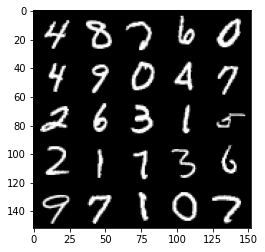

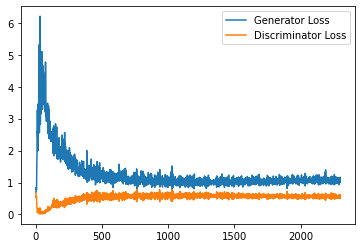

Step 46500: Generator loss: 1.0778932889699937, discriminator loss: 0.5605835325717926


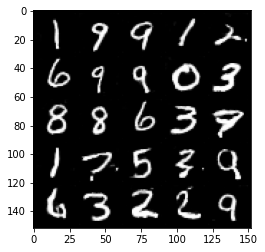

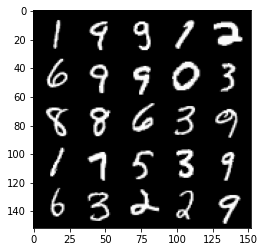

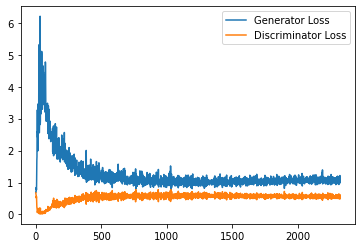

Step 47000: Generator loss: 1.0724416204690934, discriminator loss: 0.5601121504306793


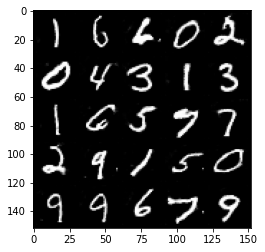

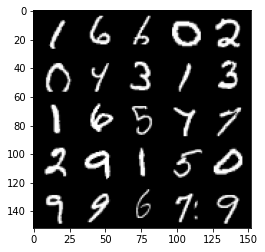

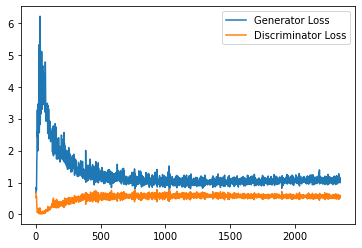

Step 47500: Generator loss: 1.0846739492416382, discriminator loss: 0.5589307224154473


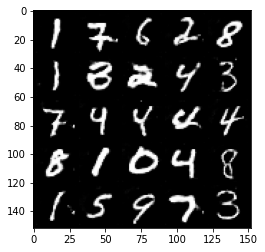

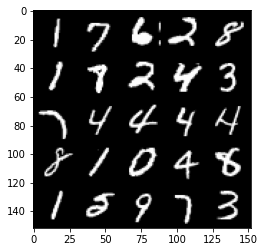

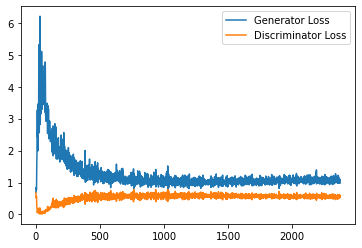

Step 48000: Generator loss: 1.0947821202278136, discriminator loss: 0.5582942438721656


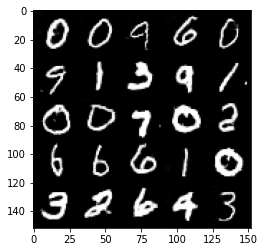

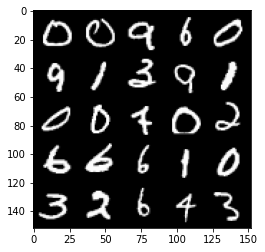

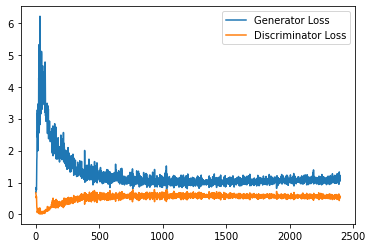

Step 48500: Generator loss: 1.098567330956459, discriminator loss: 0.5543934421539307


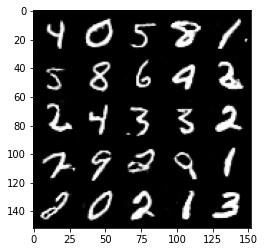

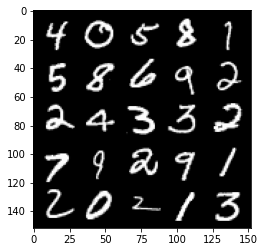

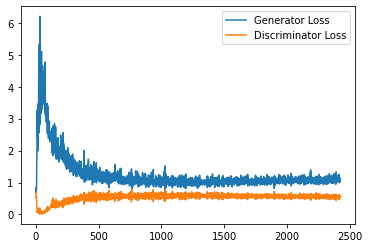

Step 49000: Generator loss: 1.089361980676651, discriminator loss: 0.5565821662545204


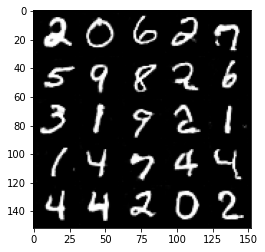

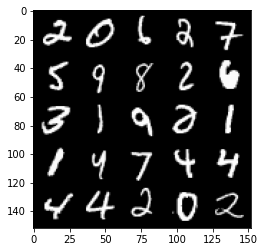

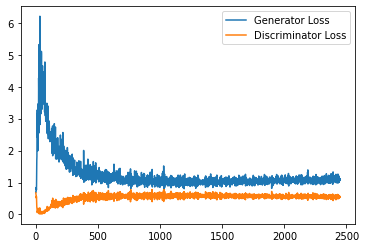

Step 49500: Generator loss: 1.104621484875679, discriminator loss: 0.5571629891991615


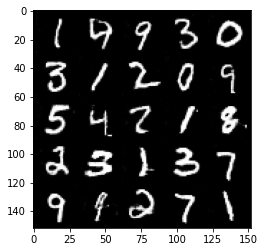

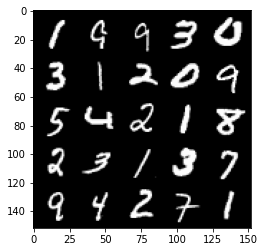

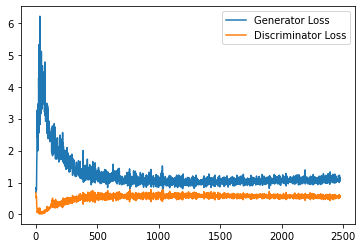

Step 50000: Generator loss: 1.0886770890951156, discriminator loss: 0.5565131855010986


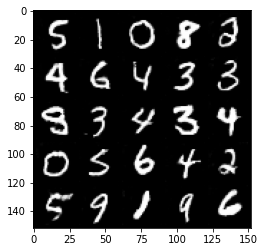

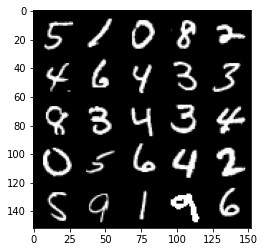

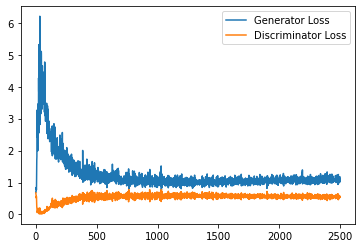

Step 50500: Generator loss: 1.100571014046669, discriminator loss: 0.5571693181395531


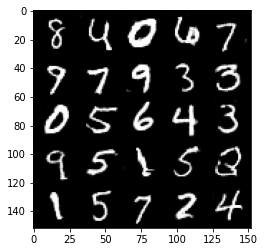

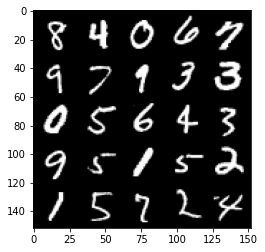

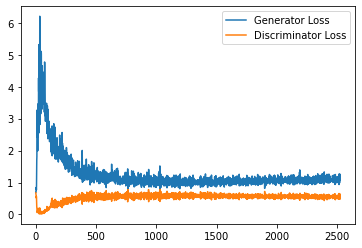

Step 51000: Generator loss: 1.1117206448316574, discriminator loss: 0.5635793597102166


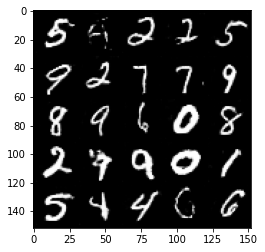

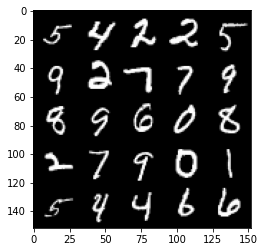

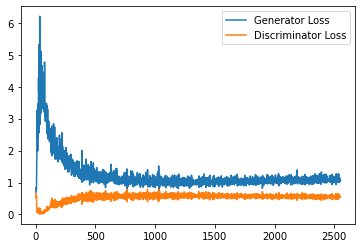

Step 51500: Generator loss: 1.0816440634727478, discriminator loss: 0.5608870016932488


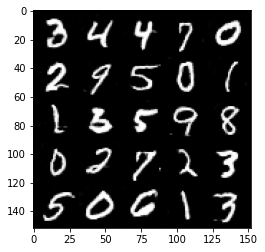

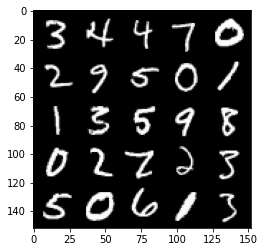

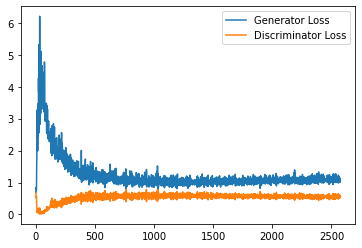

Step 52000: Generator loss: 1.106110944390297, discriminator loss: 0.5544607826471328


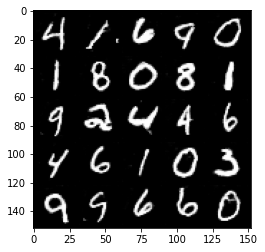

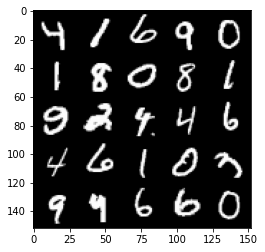

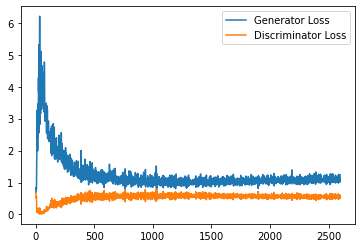

Step 52500: Generator loss: 1.0970622081756591, discriminator loss: 0.5579880180954934


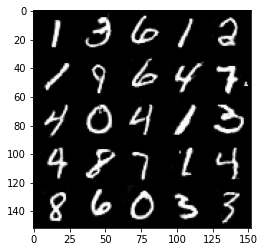

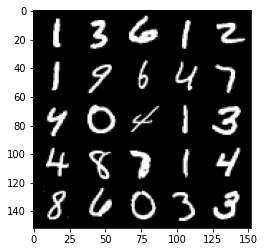

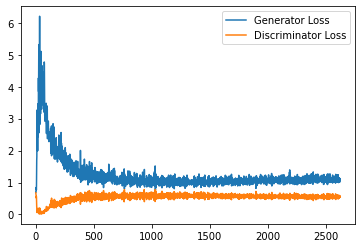

Step 53000: Generator loss: 1.092494349360466, discriminator loss: 0.5607431883215904


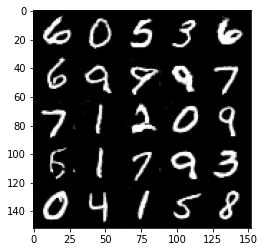

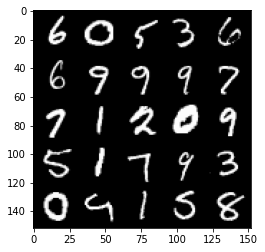

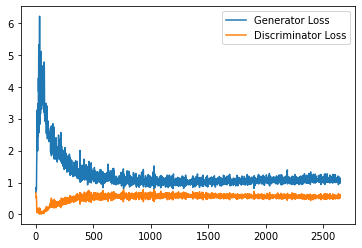

Step 53500: Generator loss: 1.0957686252593994, discriminator loss: 0.5522068094015121


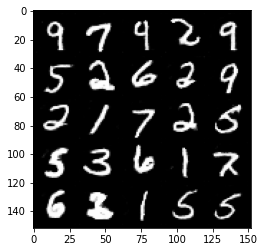

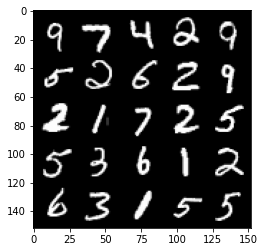

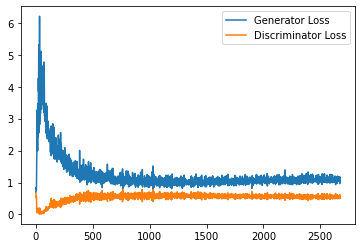

Step 54000: Generator loss: 1.1182625482082367, discriminator loss: 0.5591243568658829


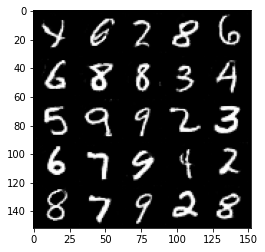

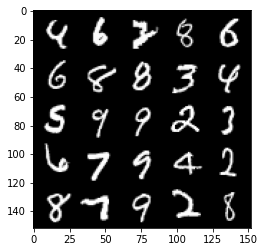

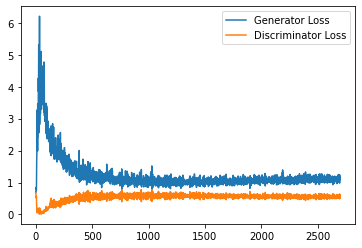

Step 54500: Generator loss: 1.1247367794513703, discriminator loss: 0.5546222445368767


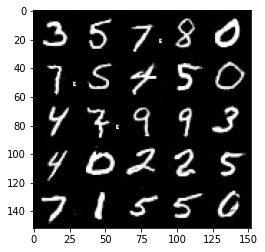

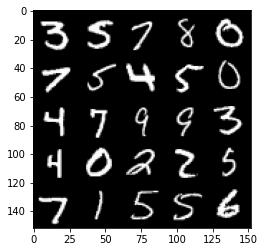

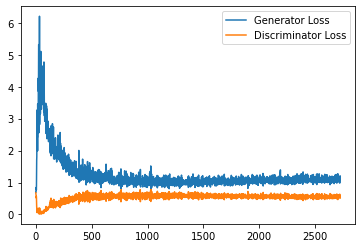

Step 55000: Generator loss: 1.089117933869362, discriminator loss: 0.5616798341274262


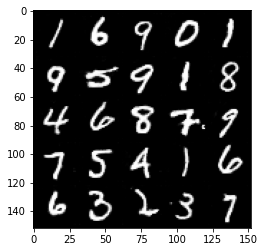

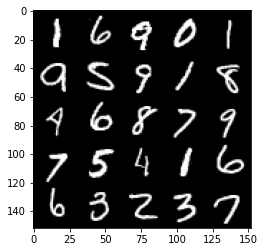

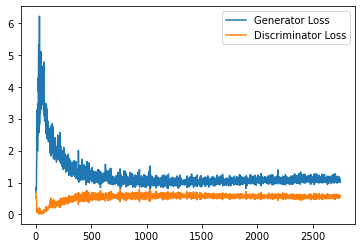

Step 55500: Generator loss: 1.0919766750335693, discriminator loss: 0.5534809286594391


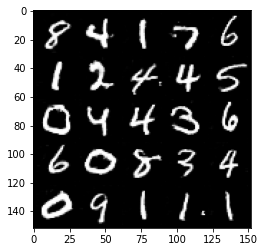

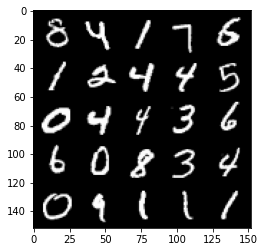

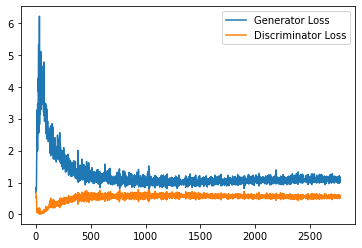

Step 56000: Generator loss: 1.117167191386223, discriminator loss: 0.5550035350918769


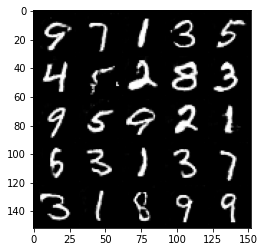

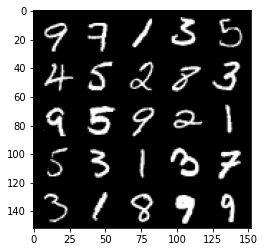

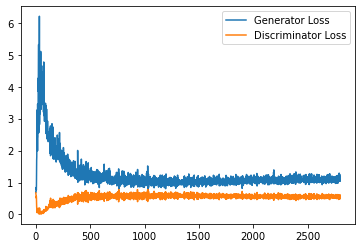

Step 56500: Generator loss: 1.1186643999814987, discriminator loss: 0.5599340925812721


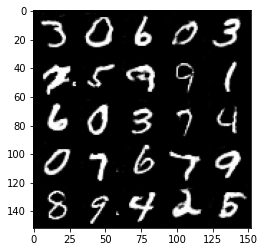

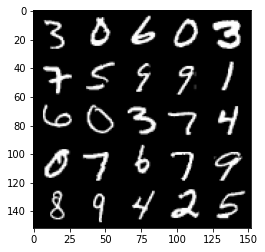

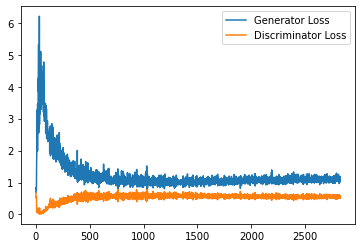

Step 57000: Generator loss: 1.103919541478157, discriminator loss: 0.551289722263813


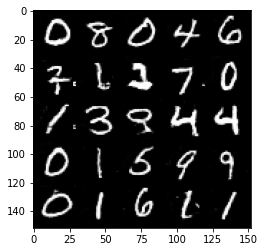

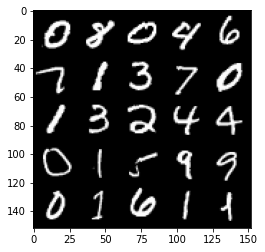

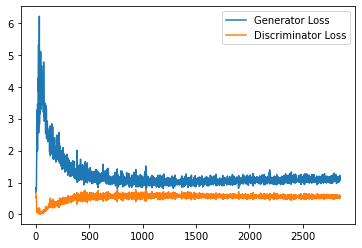

Step 57500: Generator loss: 1.1292827093601228, discriminator loss: 0.556442498922348


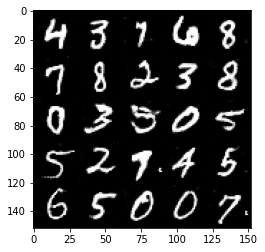

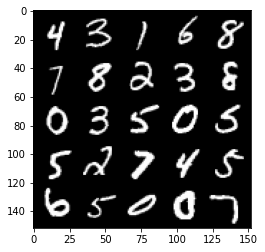

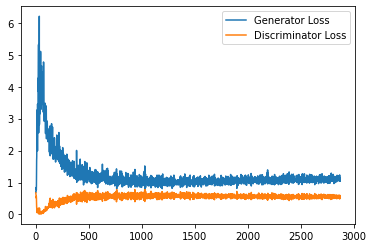

Step 58000: Generator loss: 1.1187605825662612, discriminator loss: 0.5634711818695068


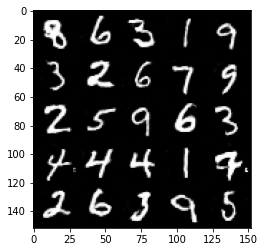

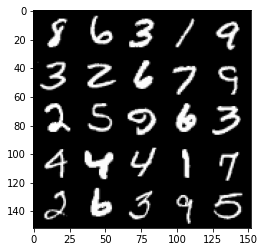

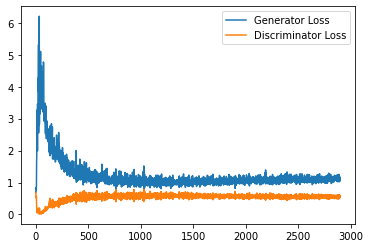

Step 58500: Generator loss: 1.0909126381874084, discriminator loss: 0.5566036034822464


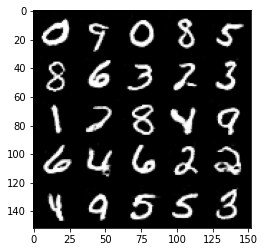

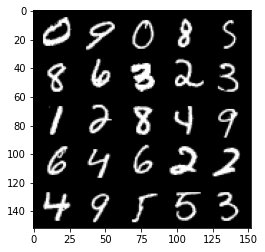

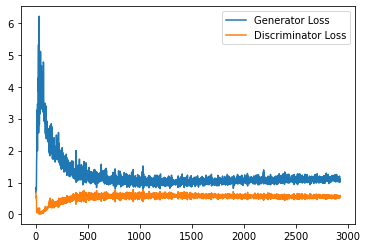

Step 59000: Generator loss: 1.1085584741830825, discriminator loss: 0.5545628834962845


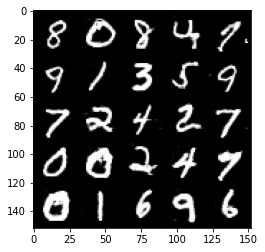

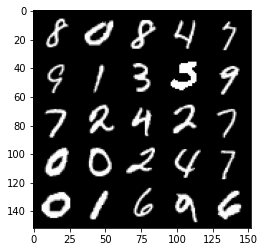

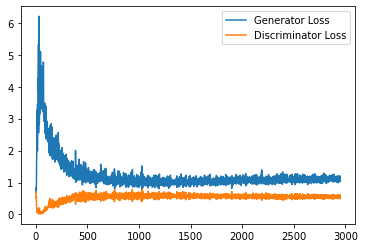

Step 59500: Generator loss: 1.150943244934082, discriminator loss: 0.5528506207466125


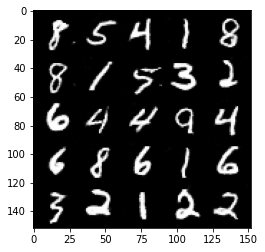

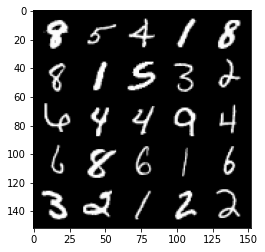

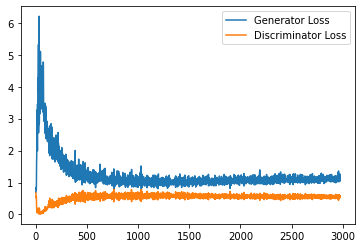

Step 60000: Generator loss: 1.113578472495079, discriminator loss: 0.5540102453231811


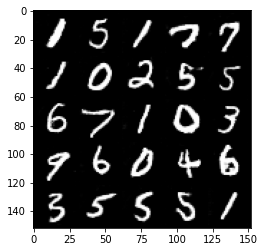

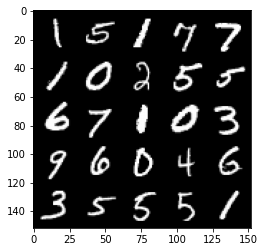

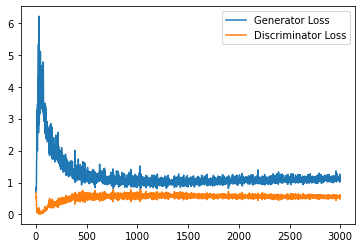

Step 60500: Generator loss: 1.1228202003240586, discriminator loss: 0.5516457560658455


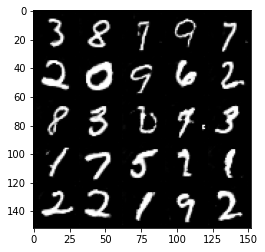

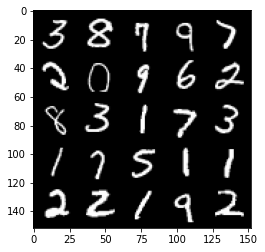

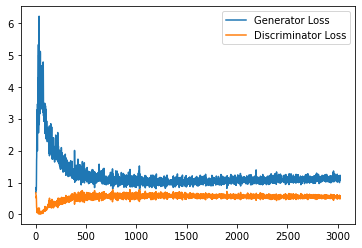

Step 61000: Generator loss: 1.1095111159086228, discriminator loss: 0.548878850877285


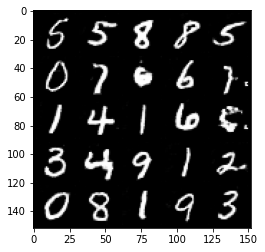

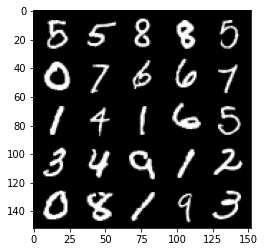

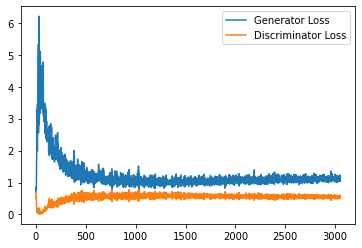

Step 61500: Generator loss: 1.152379126906395, discriminator loss: 0.5523046108484269


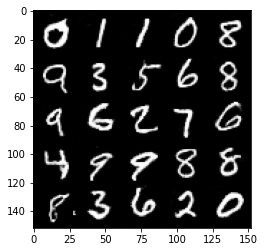

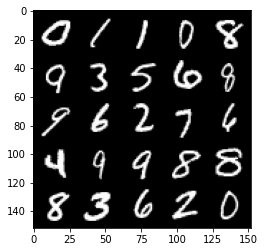

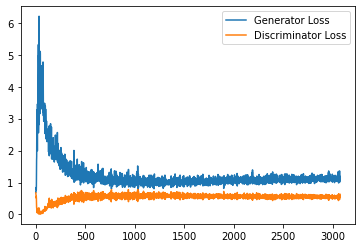

Step 62000: Generator loss: 1.1373575381040573, discriminator loss: 0.5480253452062607


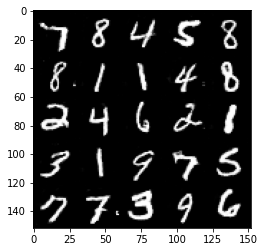

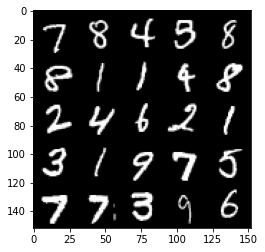

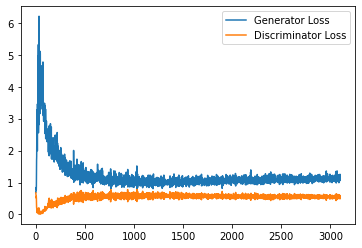

Step 62500: Generator loss: 1.1228007011413574, discriminator loss: 0.5508358979225159


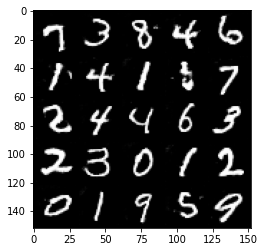

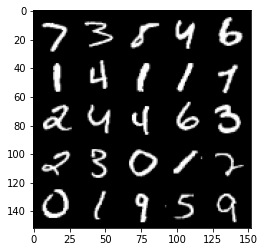

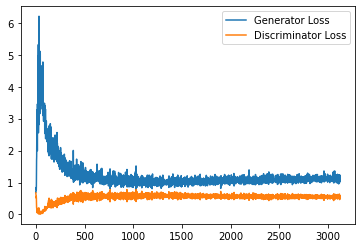

Step 63000: Generator loss: 1.1379775903224945, discriminator loss: 0.544169140458107


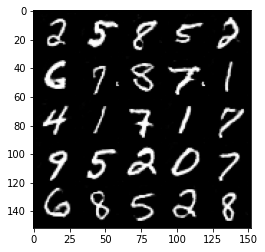

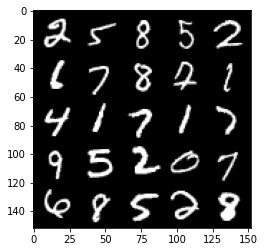

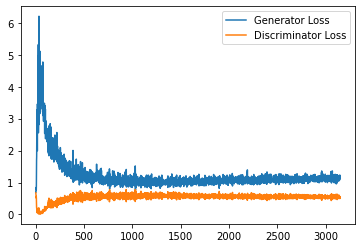

Step 63500: Generator loss: 1.1160374425649644, discriminator loss: 0.553595889210701


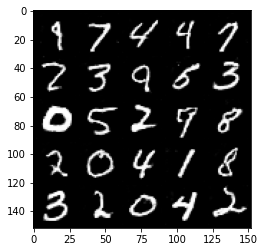

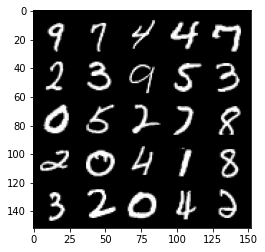

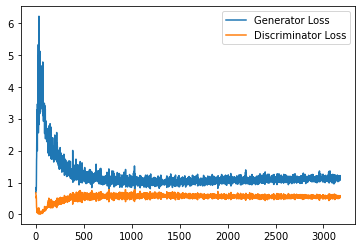

Step 64000: Generator loss: 1.1421026570796966, discriminator loss: 0.5468378689885139


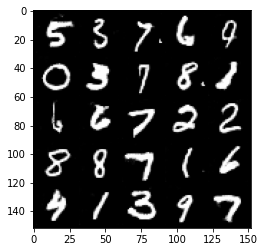

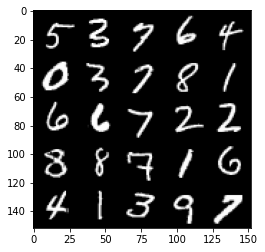

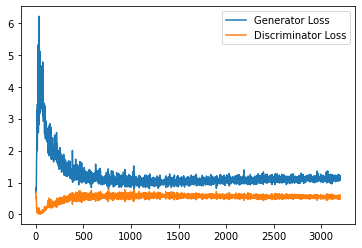

Step 64500: Generator loss: 1.1450447462797164, discriminator loss: 0.5483677390813827


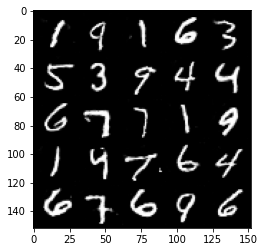

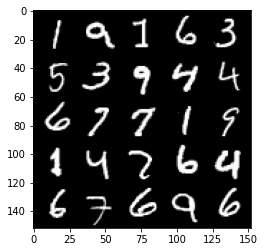

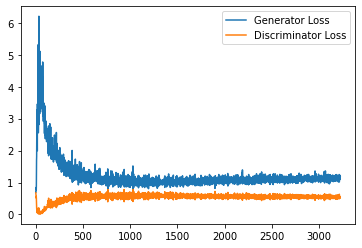

Step 65000: Generator loss: 1.128124747633934, discriminator loss: 0.5470670850276947


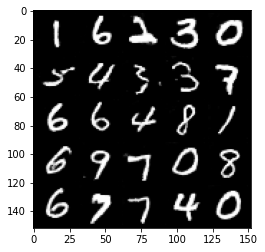

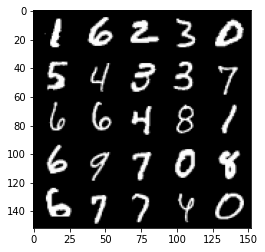

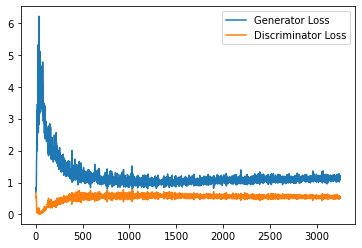

Step 65500: Generator loss: 1.1302942603826522, discriminator loss: 0.5435656666755676


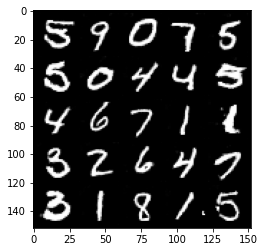

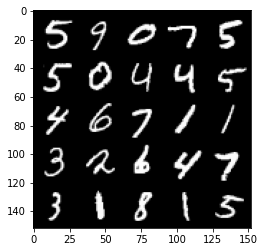

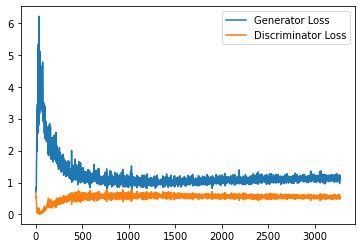

Step 66000: Generator loss: 1.1567112016677856, discriminator loss: 0.5504989728927613


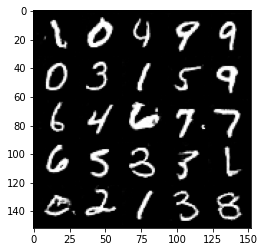

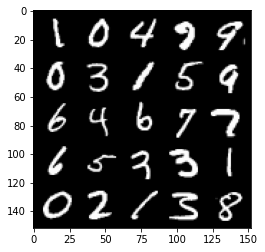

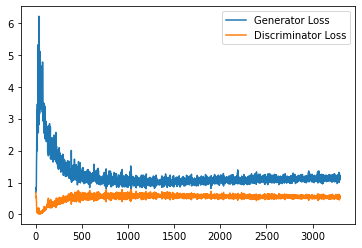

Step 66500: Generator loss: 1.1235598769187927, discriminator loss: 0.5474249932765961


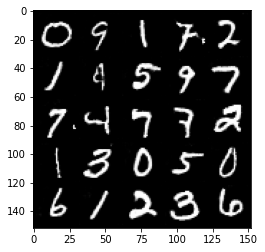

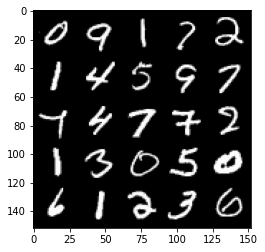

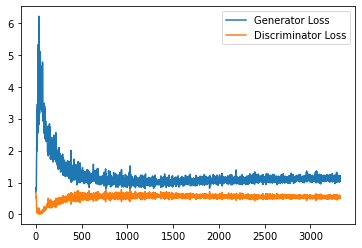

Step 67000: Generator loss: 1.1393210418224335, discriminator loss: 0.5440894131660461


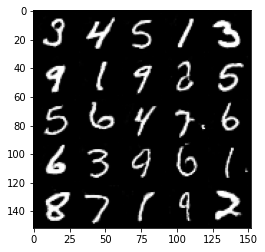

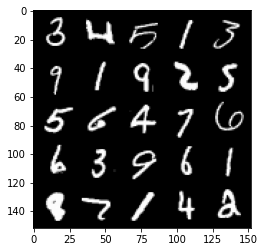

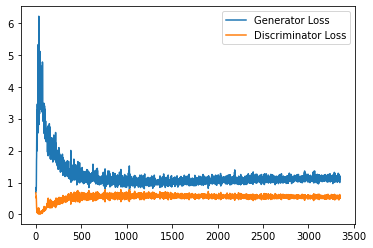

Step 67500: Generator loss: 1.1302269608974458, discriminator loss: 0.5505765492916107


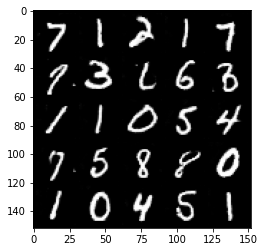

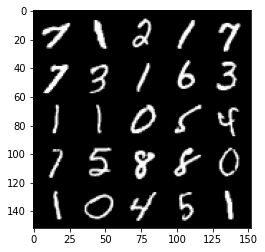

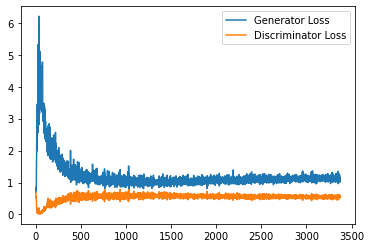

Step 68000: Generator loss: 1.1549707570075989, discriminator loss: 0.5410030213594437


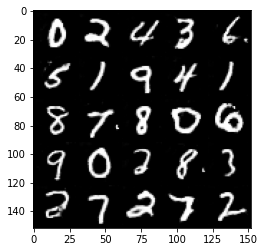

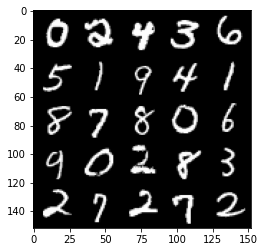

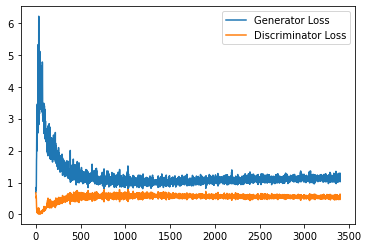

Step 68500: Generator loss: 1.1440675983428954, discriminator loss: 0.544477725148201


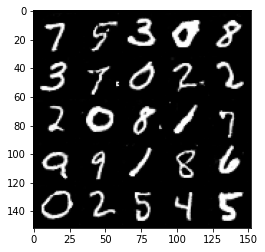

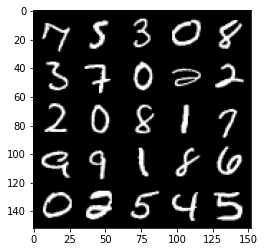

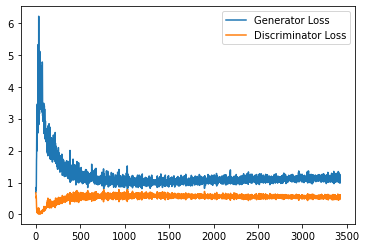

Step 69000: Generator loss: 1.1417001826763153, discriminator loss: 0.5416426092386246


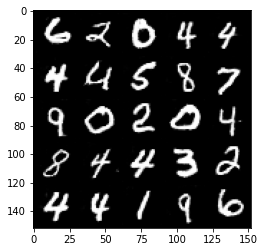

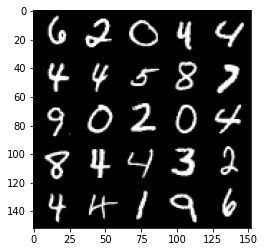

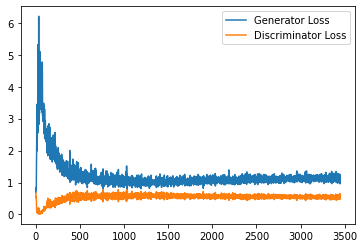

Step 69500: Generator loss: 1.150157541513443, discriminator loss: 0.5455690146684646


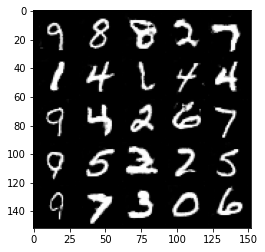

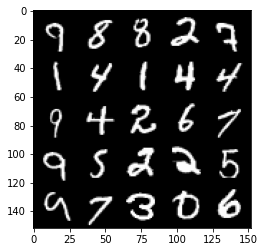

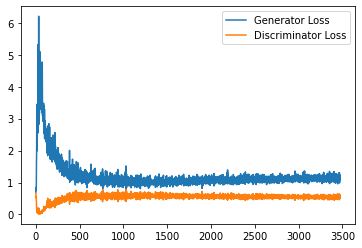

Step 70000: Generator loss: 1.158165633559227, discriminator loss: 0.5521379359960557


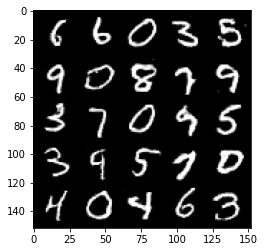

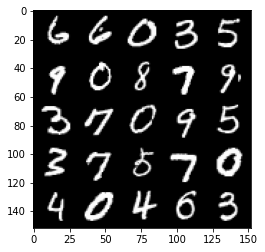

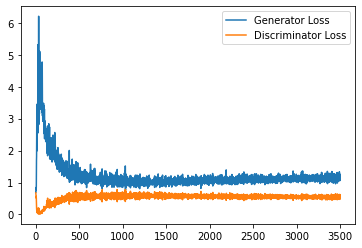

Step 70500: Generator loss: 1.1580402237176894, discriminator loss: 0.5427836545705795


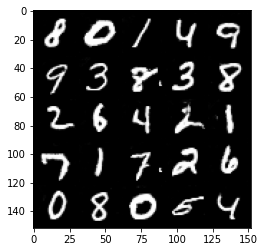

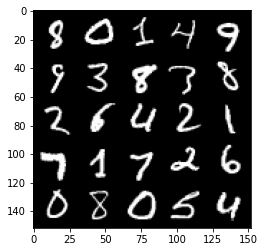

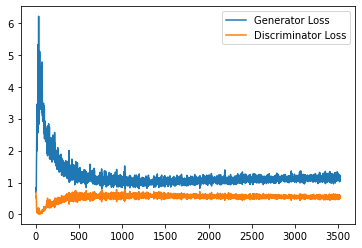

Step 71000: Generator loss: 1.146018781900406, discriminator loss: 0.5434222583174706


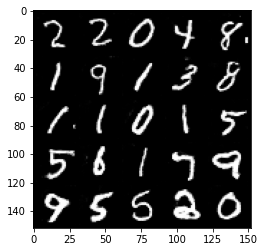

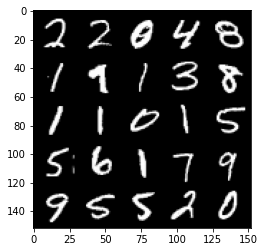

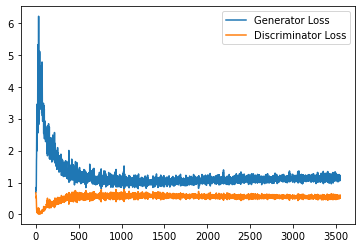

Step 71500: Generator loss: 1.1427738842964172, discriminator loss: 0.5504941140413284


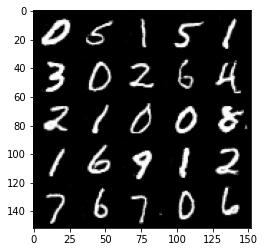

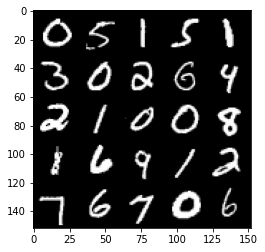

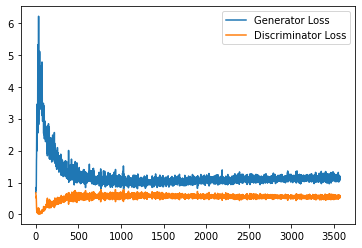

Step 72000: Generator loss: 1.1550400514602661, discriminator loss: 0.5446207158565521


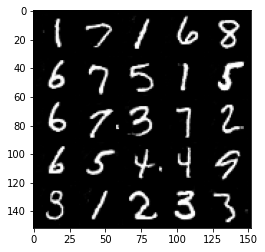

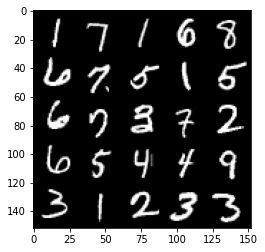

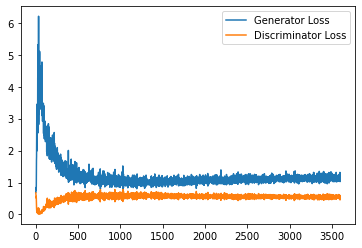

Step 72500: Generator loss: 1.1597594240903855, discriminator loss: 0.5425370644330978


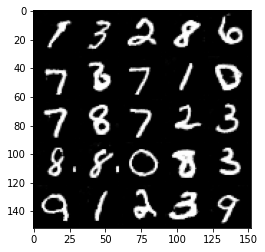

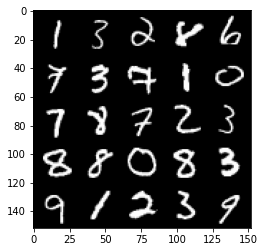

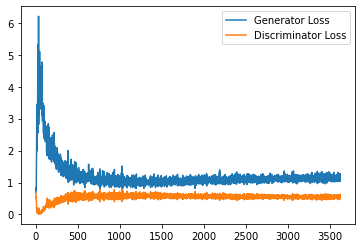

Step 73000: Generator loss: 1.142392475605011, discriminator loss: 0.5472581707835198


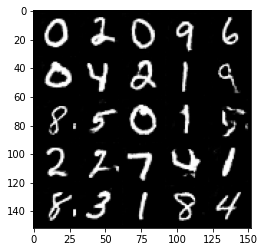

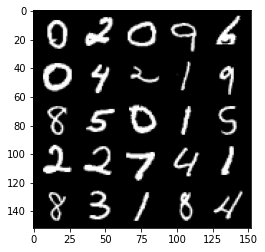

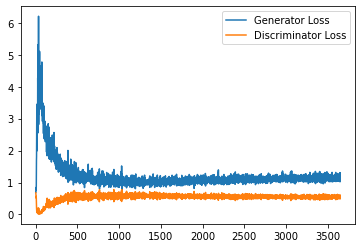

Step 73500: Generator loss: 1.1696937844753266, discriminator loss: 0.5455605441331863


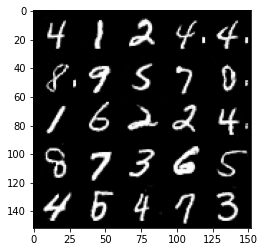

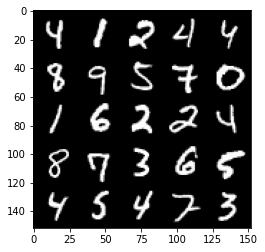

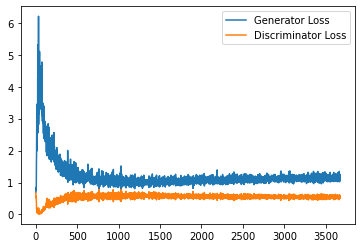

Step 74000: Generator loss: 1.145415627837181, discriminator loss: 0.5452097970247268


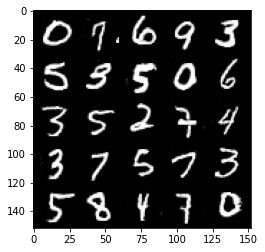

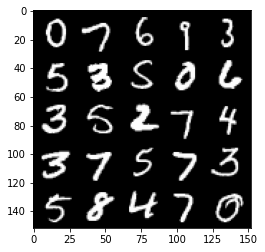

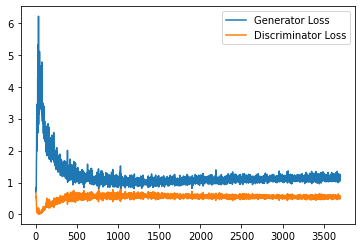

Step 74500: Generator loss: 1.1562730762958526, discriminator loss: 0.5526636735200882


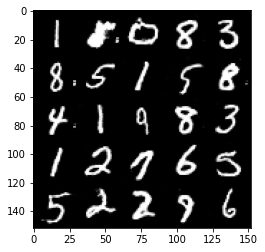

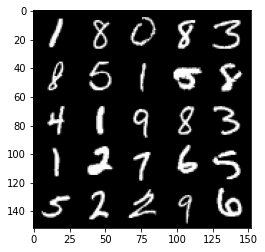

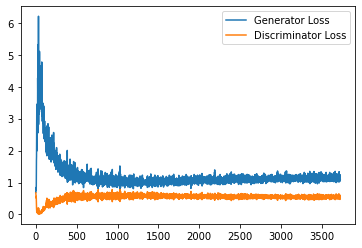

Step 75000: Generator loss: 1.138521740436554, discriminator loss: 0.5423407654762268


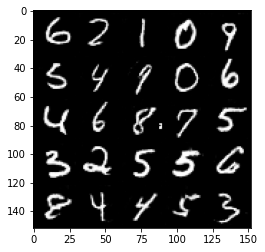

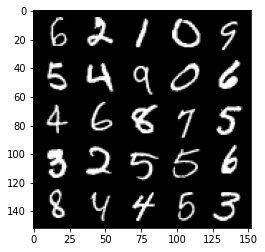

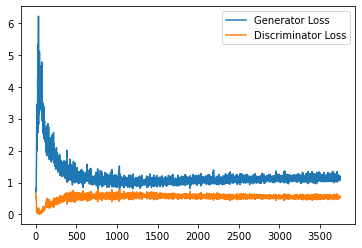

Step 75500: Generator loss: 1.144668885588646, discriminator loss: 0.5477447597980499


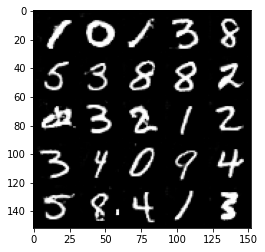

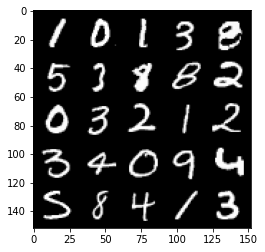

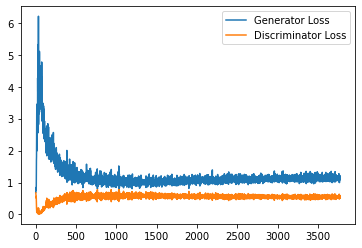

Step 76000: Generator loss: 1.162018592953682, discriminator loss: 0.5481666539907455


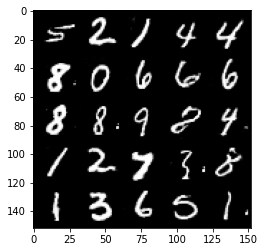

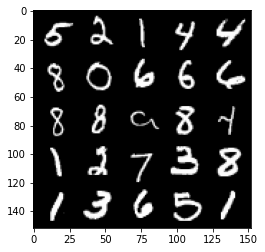

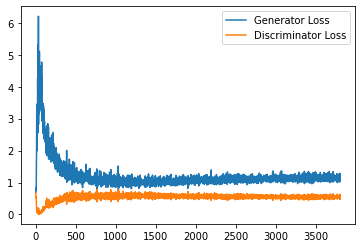

Step 76500: Generator loss: 1.1874912922382355, discriminator loss: 0.549764638543129


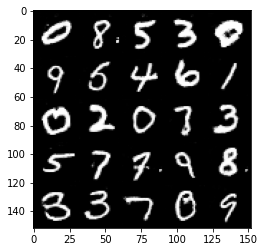

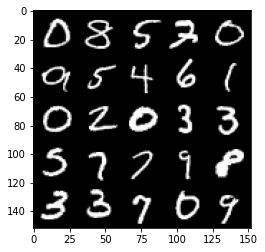

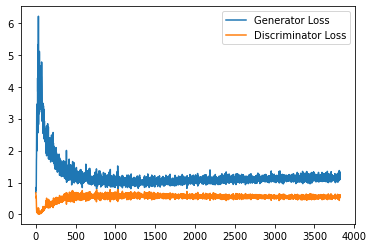

Step 77000: Generator loss: 1.1749751769304275, discriminator loss: 0.5435496321320534


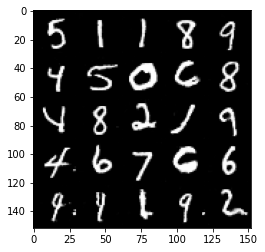

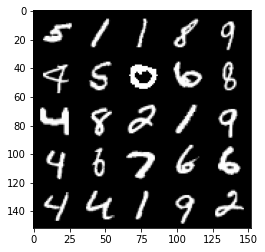

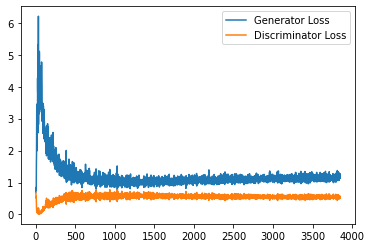

Step 77500: Generator loss: 1.1704203346967696, discriminator loss: 0.5471915189027786


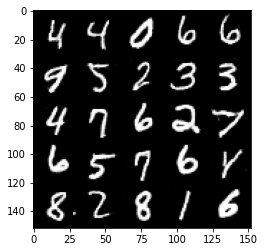

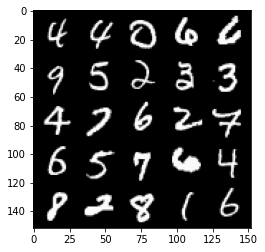

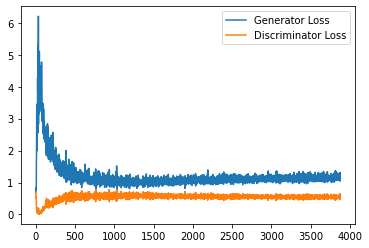

Step 78000: Generator loss: 1.1838626883029937, discriminator loss: 0.5475842865109444


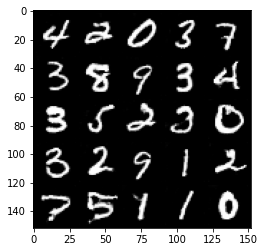

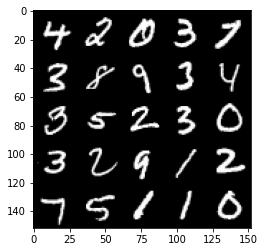

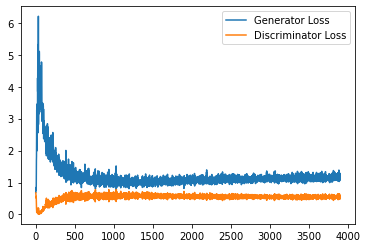

Step 78500: Generator loss: 1.137345950603485, discriminator loss: 0.5506975218057633


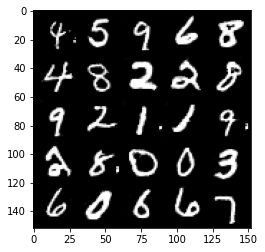

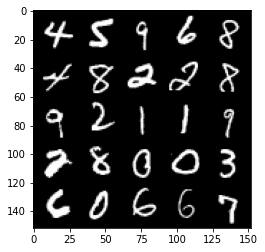

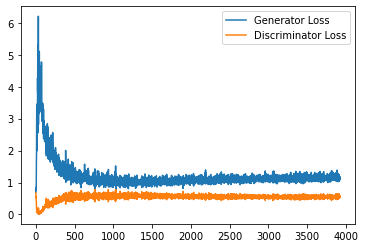

Step 79000: Generator loss: 1.1612684355974197, discriminator loss: 0.5470910518765449


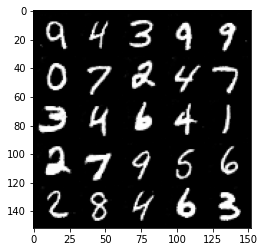

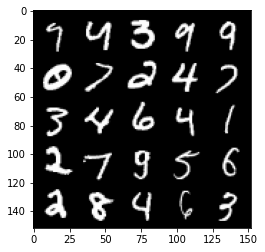

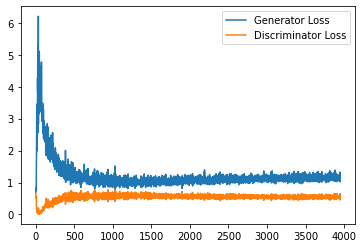

Step 79500: Generator loss: 1.1600323798656464, discriminator loss: 0.5486437537074089


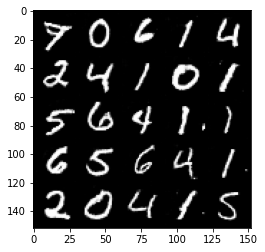

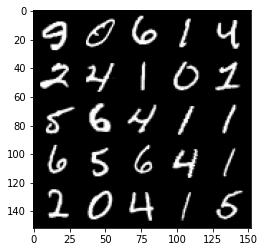

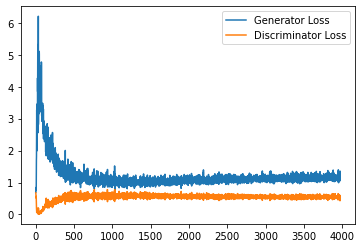

Step 80000: Generator loss: 1.1711802728176117, discriminator loss: 0.5426964676976204


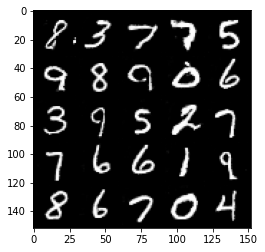

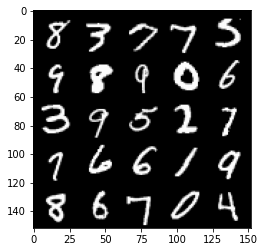

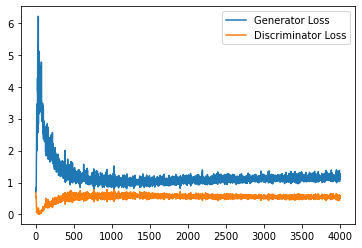

Step 80500: Generator loss: 1.167514643549919, discriminator loss: 0.5545938524007797


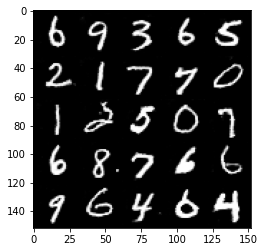

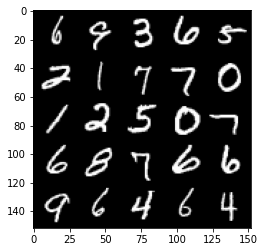

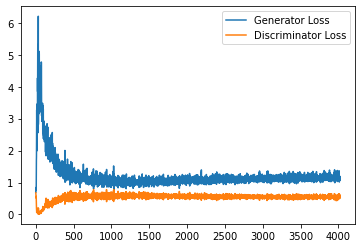

Step 81000: Generator loss: 1.155090376019478, discriminator loss: 0.5494539985656738


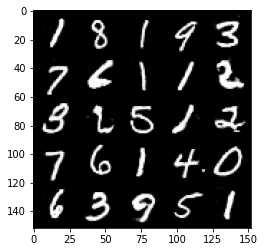

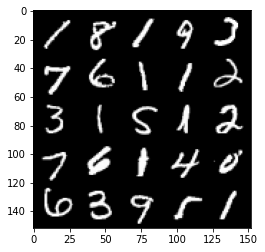

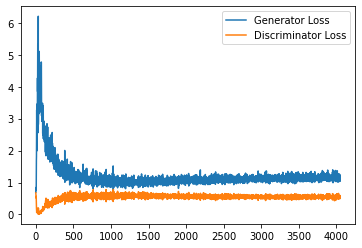

Step 81500: Generator loss: 1.1637464742660522, discriminator loss: 0.5487701544761657


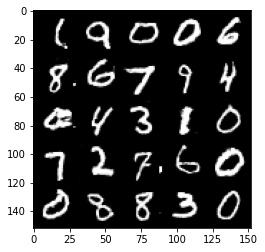

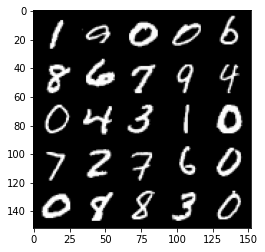

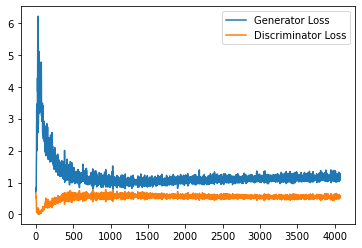

Step 82000: Generator loss: 1.1784437830448151, discriminator loss: 0.5521628012061119


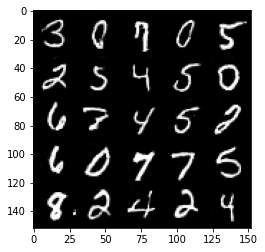

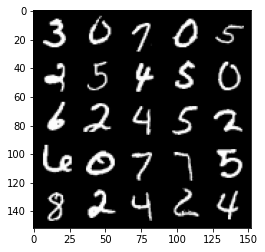

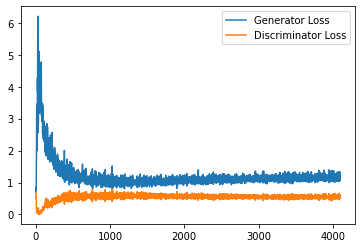

Step 82500: Generator loss: 1.1473172006607055, discriminator loss: 0.5513757662773132


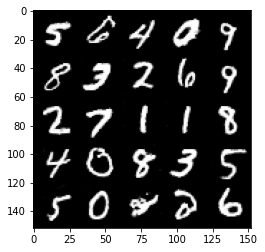

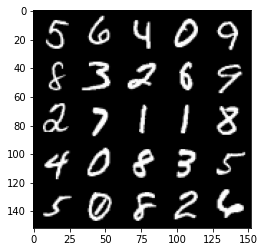

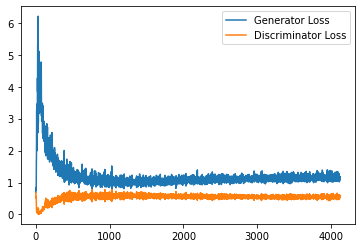

Step 83000: Generator loss: 1.1550149098634719, discriminator loss: 0.5484003605246544


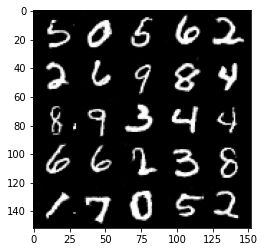

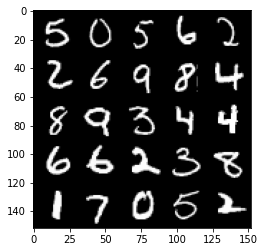

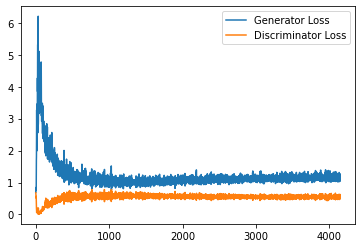

Step 83500: Generator loss: 1.15522307908535, discriminator loss: 0.5471584259867668


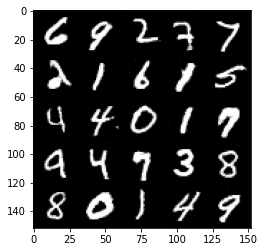

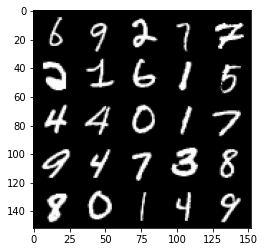

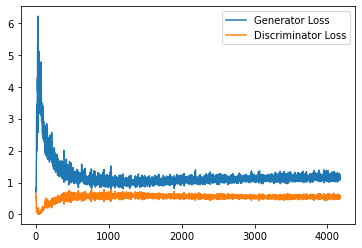

Step 84000: Generator loss: 1.1739545006752015, discriminator loss: 0.5512415003776551


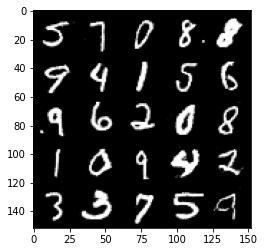

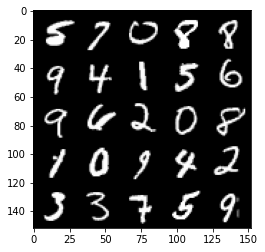

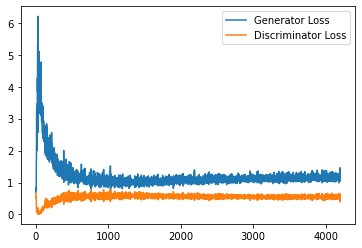

Step 84500: Generator loss: 1.1733184732198716, discriminator loss: 0.5474304868578911


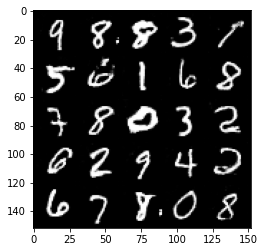

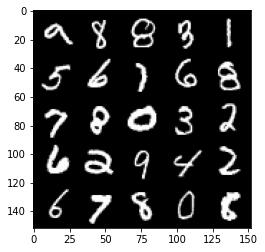

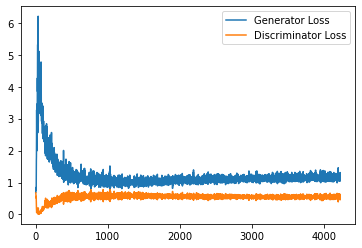

Step 85000: Generator loss: 1.1415206450223923, discriminator loss: 0.5513619723916053


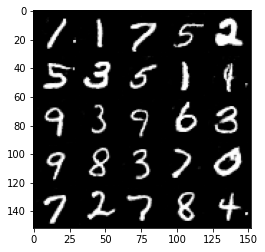

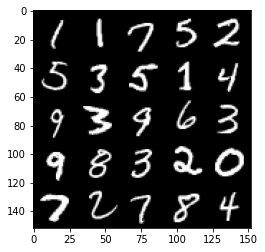

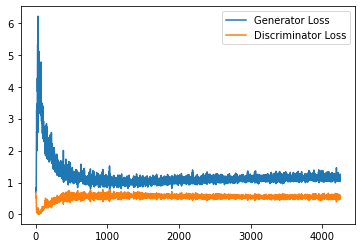

Step 85500: Generator loss: 1.148605631709099, discriminator loss: 0.5579015032649041


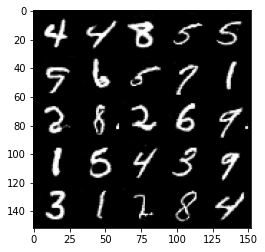

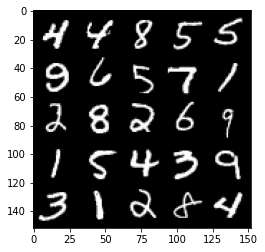

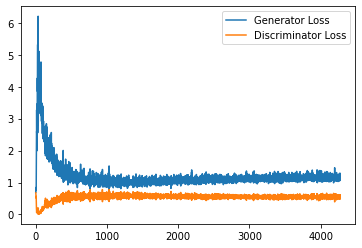

Step 86000: Generator loss: 1.1616372544765472, discriminator loss: 0.5517540683150292


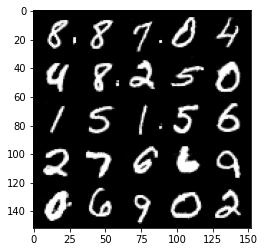

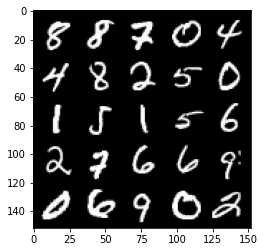

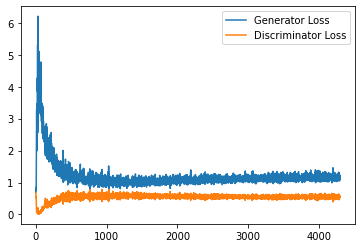

Step 86500: Generator loss: 1.1642248173952103, discriminator loss: 0.5504191026091576


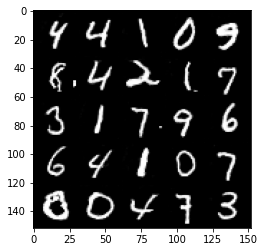

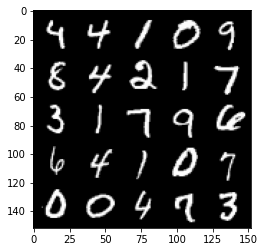

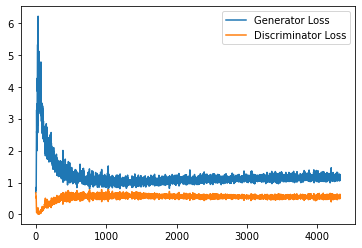

Step 87000: Generator loss: 1.1403377467393876, discriminator loss: 0.5536138959527016


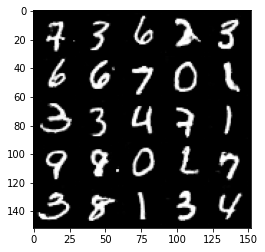

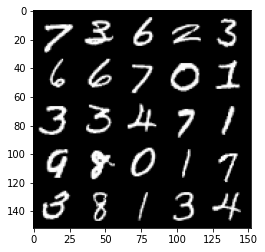

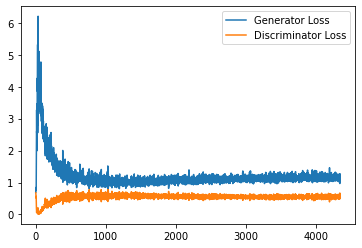

Step 87500: Generator loss: 1.1457121443748475, discriminator loss: 0.5528854115009307


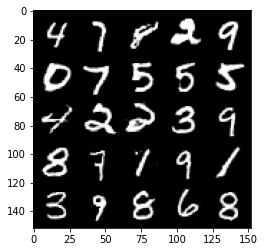

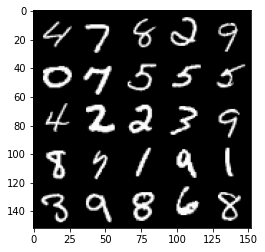

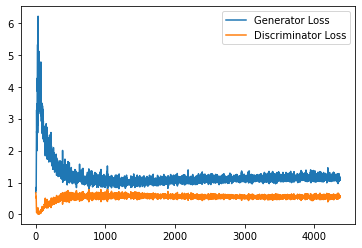

Step 88000: Generator loss: 1.1369078538417816, discriminator loss: 0.5521487464904785


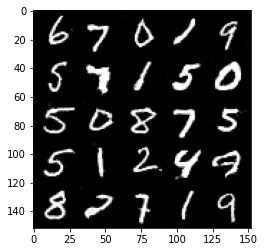

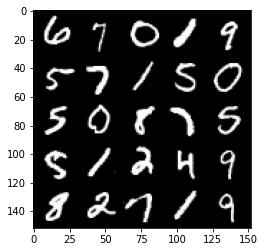

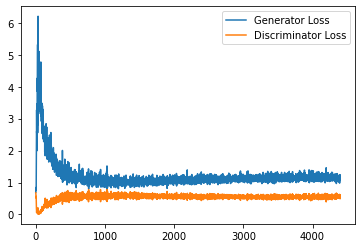

Step 88500: Generator loss: 1.1494685562849045, discriminator loss: 0.5573281468749046


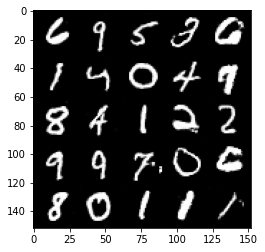

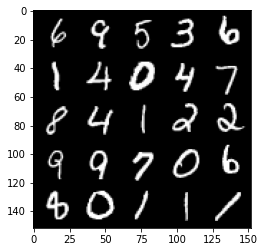

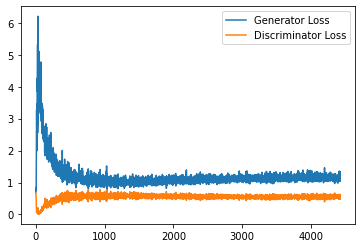

Step 89000: Generator loss: 1.1496665151119232, discriminator loss: 0.5559573075771331


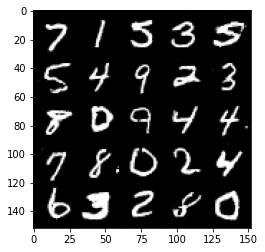

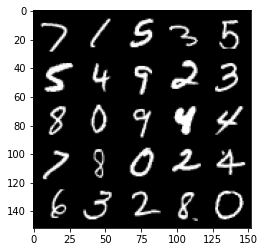

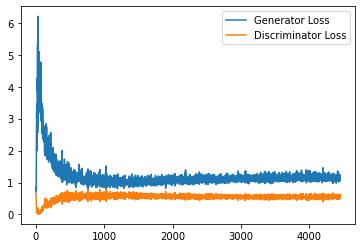

KeyboardInterrupt: 

In [10]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)
        #if epoch==1:
        #    print(f"real shape {real.shape}")

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise,one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(),image_one_hot_labels)
        real_image_and_labels = combine_vectors(real,image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [11]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

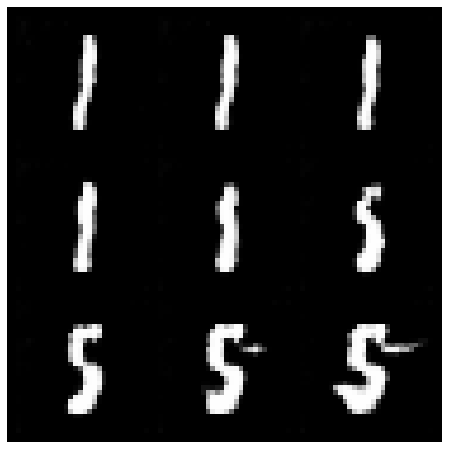

In [14]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

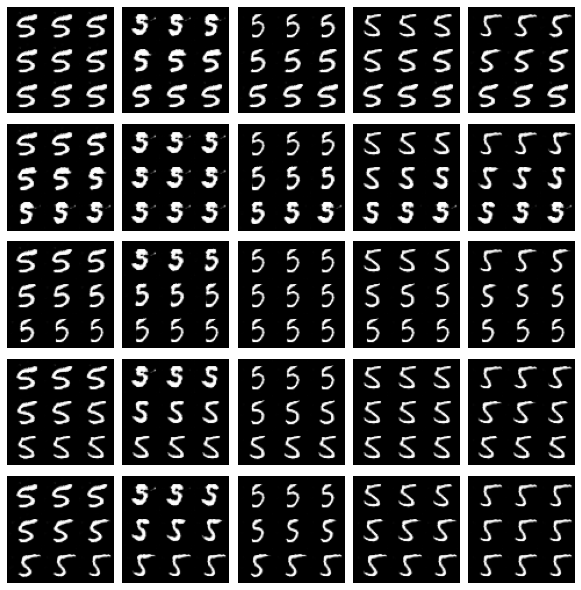

In [15]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()